<a href="https://colab.research.google.com/github/matteo9910/StressDetectionBasedOnWearableSensorData/blob/main/CAMPANELLA_PREPROCESSING.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import warnings
warnings.filterwarnings('ignore')

In [ ]:
import zipfile
import os
import pandas as pd
import pickle
import matplotlib.pyplot as plt
from scipy.signal import butter, filtfilt, iirnotch
import seaborn as sns
import scipy.stats as stats
import numpy as np
from scipy.stats import shapiro
import math
from scipy.stats import mannwhitneyu
from scipy.signal import welch
import ipywidgets as widgets
from IPython.display import display
import statsmodels.api as sm
from statsmodels.formula.api import ols
from scipy.signal import resample
from scipy.signal import find_peaks
import scipy.signal
import math

In [ ]:
def parse_numeric_value(x):
    """Pulisce una stringa con più punti nel numero, mantenendo solo il primo come separatore decimale."""
    try:
        if isinstance(x, str):
            x = x.strip().replace(' ', '')  # Rimuove spazi
            if x.count('.') > 1:
                parts = x.split('.')
                return float(parts[0] + '.' + ''.join(parts[1:]))
            return float(x)
        return float(x)
    except:
        return np.nan

In [ ]:
def load_empatica_subjects_data(base_path, target_freq=64):
    """
    Carica, pulisce e normalizza i segnali da cartelle Empatica in un unico DataFrame.
    """
    freq_map = {
        'ACC': 32,
        'BVP': 64,
        'EDA': 4,
        'TEMP': 4
    }

    signal_files = ['ACC.csv', 'BVP.csv', 'EDA.csv', 'TEMP.csv']
    subjects = sorted([d for d in os.listdir(base_path) if d.startswith("subject_")])
    all_data = []

    for subject in subjects:
        subject_path = os.path.join(base_path, subject)
        signals = {}

        for signal_name in signal_files:
            file_path = os.path.join(subject_path, signal_name)
            try:
                # Caricamento file, parsing numerico sicuro su ogni colonna
                raw_data = pd.read_csv(file_path, header=None)
                for col in raw_data.columns:
                    raw_data[col] = raw_data[col].map(parse_numeric_value)

                # Frequenza originale
                orig_freq = freq_map[signal_name.split('.')[0]]
                n_samples = int(len(raw_data) * target_freq / orig_freq)

                # Resample
                resampled = resample(raw_data.values, n_samples, axis=0)

                if signal_name == 'ACC.csv':
                    signals['acc1'] = resampled[:, 0]
                    signals['acc2'] = resampled[:, 1]
                    signals['acc3'] = resampled[:, 2]
                else:
                    key = signal_name.split('.')[0].lower()
                    signals[key] = resampled.squeeze()

            except Exception as e:
                print(f"Errore caricando {file_path}: {e}")
                continue

        # Allineamento lunghezze
        min_len = min(len(sig) for sig in signals.values())
        for k in signals:
            signals[k] = signals[k][:min_len]

        df_subject = pd.DataFrame(signals)
        df_subject['subject'] = subject
        all_data.append(df_subject)

    return pd.concat(all_data, ignore_index=True)

In [ ]:
df = load_empatica_subjects_data('/content/drive/MyDrive/CAMPANELLA ET.AL DATASET/Subjects')

In [ ]:
print("Shape of DF:", df.shape)
df.head()

Shape of DF: (4149992, 7)


,acc1,acc2,acc3,bvp,eda,temp,subject
0,-11.000000,-42.000000,47.000000,-5.081451e-15,6.160874e-15,32.680000,subject_01
1,-3.731070,-48.832680,53.868799,-5.371820e-14,-2.176869e-01,32.693612,subject_01
2,-12.000000,-42.000000,48.000000,-5.081451e-15,-3.885328e-01,32.704953,subject_01
3,-17.019673,-38.224616,44.537763,-2.499893e-14,-5.120843e-01,32.713979,subject_01
4,-13.000000,-42.000000,48.000000,2.958131e-14,-5.889338e-01,32.720702,subject_01


In [ ]:
def assign_protocol_phases(df, fs=64):
    """
    Assegna una colonna 'protocol_phase' al DataFrame identificando le fasi del protocollo:
    - Rest 1, Task 1, Rest 2, Task 2, Rest 3, Task 3, Rest 4 (primi 27 minuti)
    - final_stress_phase (dal minuto 28 fino a -5 minuti dalla fine)
    - final_protocol_pattern (ultimi 5 minuti del protocollo)
    """
    samples_per_minute = fs * 60
    phase_names = [
        ('rest_1', 3),
        ('task_1', 10),
        ('rest_2', 2),
        ('task_2', 5),
        ('rest_3', 2),
        ('task_3', 3),
        ('rest_4', 2)
    ]

    labeled_data = []

    for subject in df['subject'].unique():
        df_subj = df[df['subject'] == subject].reset_index(drop=True)
        total_samples = len(df_subj)
        total_duration_min = total_samples // samples_per_minute

        protocol_phase = [''] * total_samples
        pointer = 0

        # Assegna le prime 7 fasi (fino al minuto 27)
        for name, duration in phase_names:
            n_samples = duration * samples_per_minute
            end = pointer + n_samples
            protocol_phase[pointer:end] = [name] * min(n_samples, total_samples - pointer)
            pointer = end
            if pointer >= total_samples:
                break

        # Assegna "final_stress_phase" dal minuto 28 fino agli ultimi 5 minuti
        last_5_start = total_samples - 5 * samples_per_minute
        while pointer < last_5_start:
            protocol_phase[pointer] = "final_stress_phase"
            pointer += 1

        # Assegna "final_protocol_pattern" agli ultimi 5 minuti
        while pointer < total_samples:
            protocol_phase[pointer] = "final_protocol_pattern"
            pointer += 1

        df_subj['protocol_phase'] = protocol_phase
        labeled_data.append(df_subj)

    return pd.concat(labeled_data, ignore_index=True)

In [ ]:
df = assign_protocol_phases(df, fs=64)

In [ ]:
df['acc_mag'] = np.sqrt(df['acc1']**2 + df['acc2']**2 + df['acc3']**2)
df = df.drop(columns=['acc1', 'acc2', 'acc3'], axis = 1)

In [ ]:
df.head()

,bvp,eda,temp,subject,protocol_phase,acc_mag
0,-5.081451e-15,6.160874e-15,32.680000,subject_01,rest_1,63.984373
1,-5.371820e-14,-2.176869e-01,32.693612,subject_01,rest_1,72.803839
2,-5.081451e-15,-3.885328e-01,32.704953,subject_01,rest_1,64.899923
3,-2.499893e-14,-5.120843e-01,32.713979,subject_01,rest_1,61.109760
4,2.958131e-14,-5.889338e-01,32.720702,subject_01,rest_1,65.092242


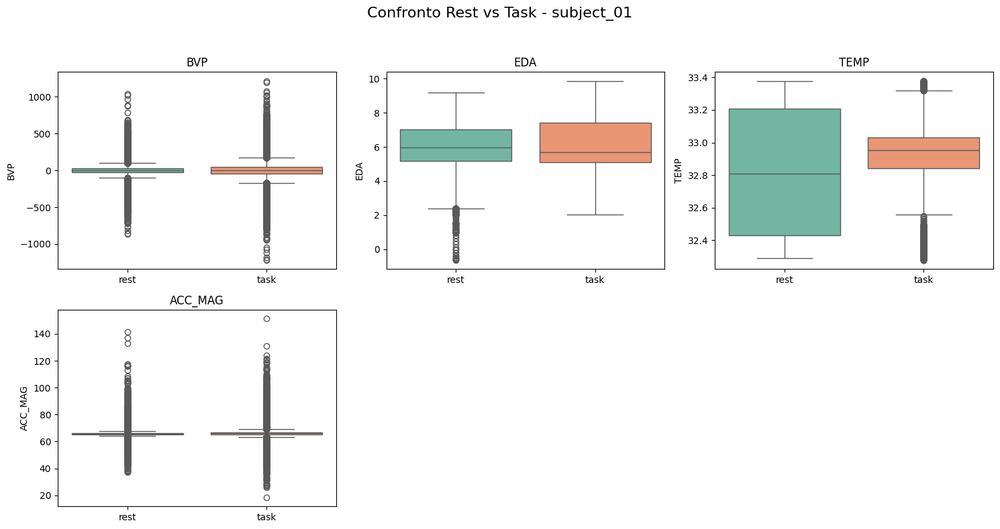

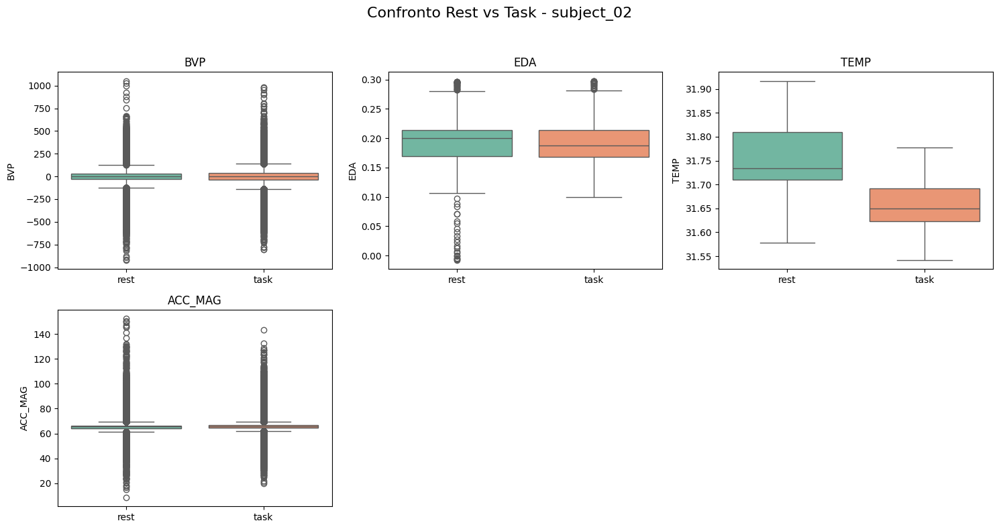

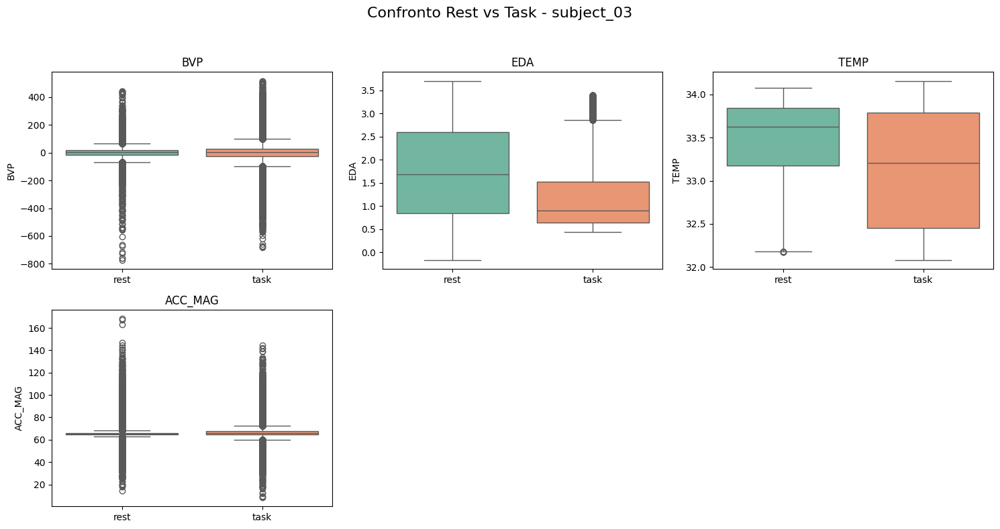

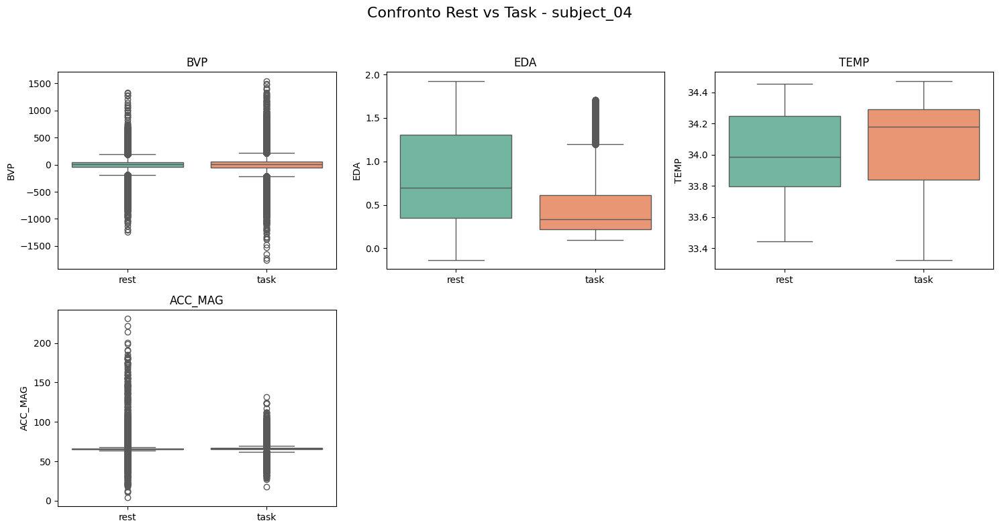

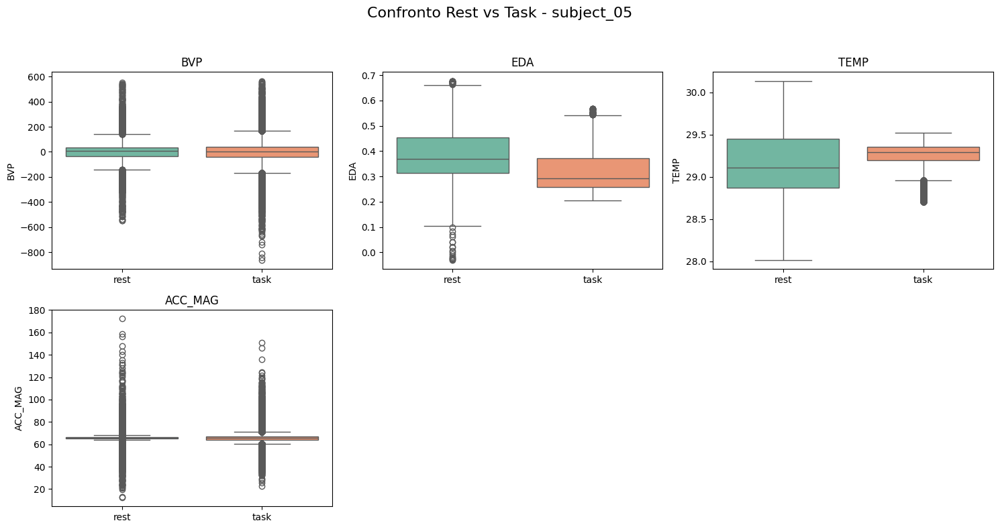

...

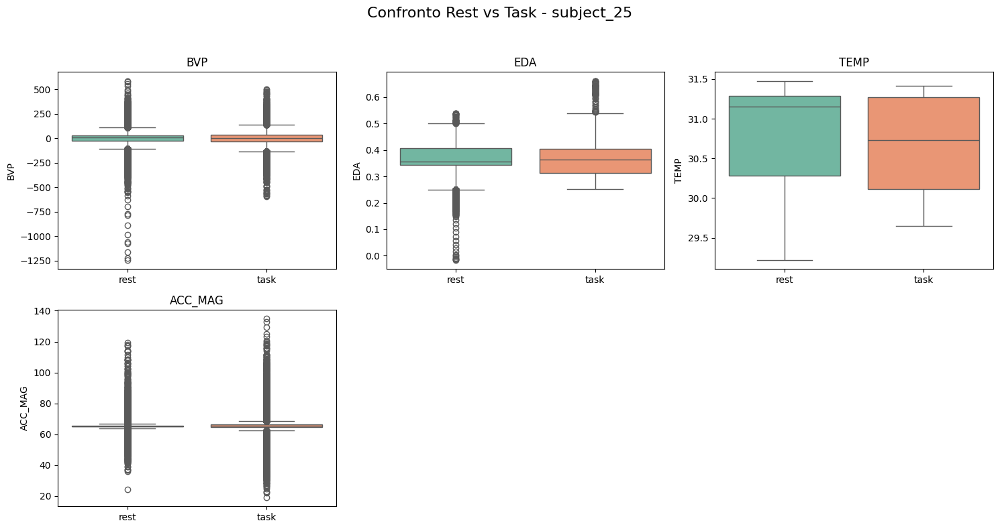

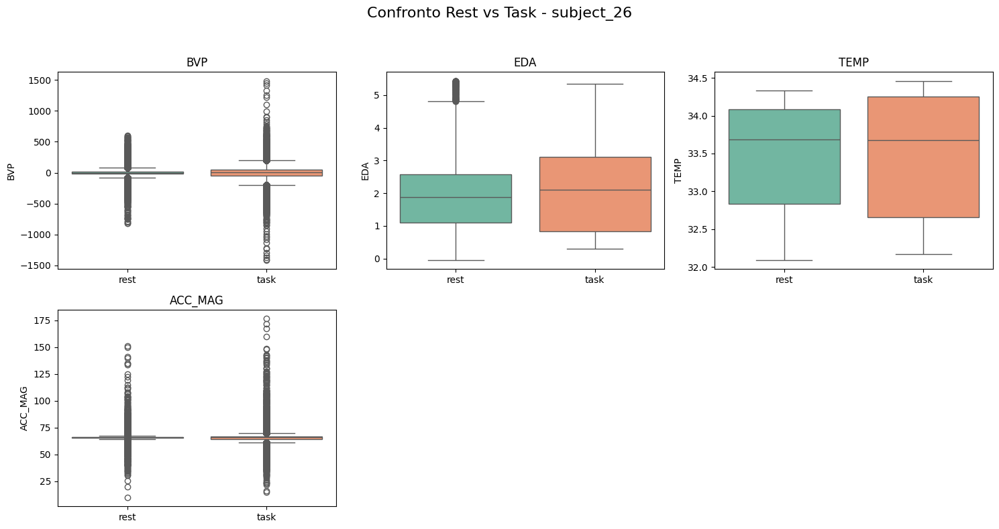

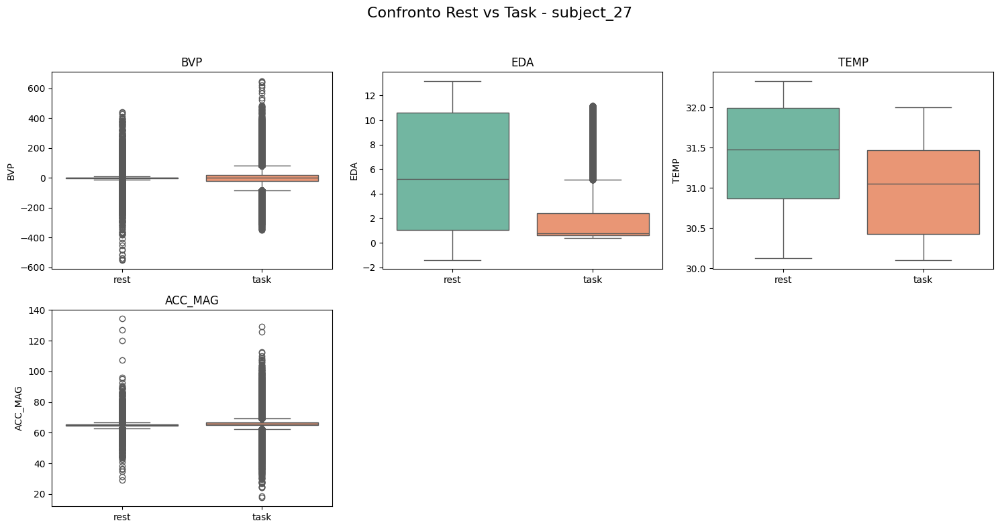

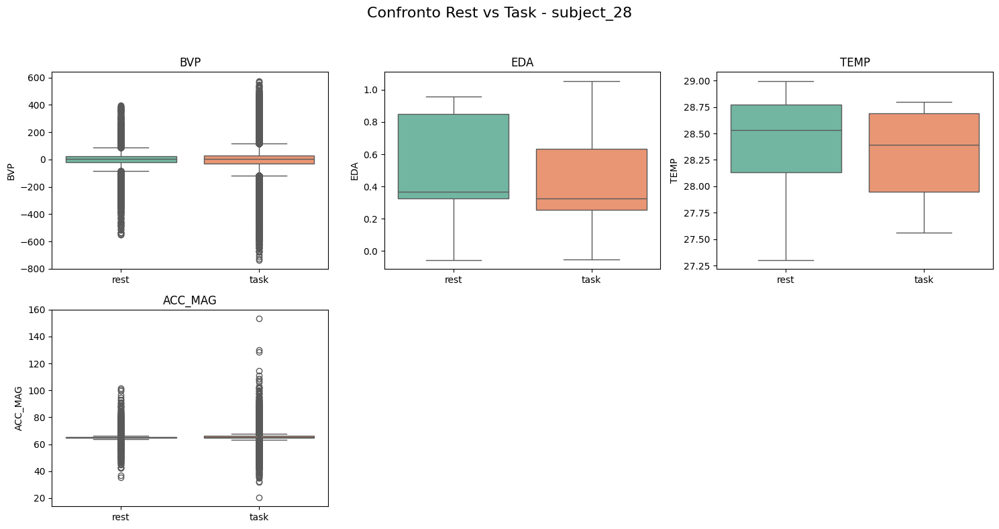

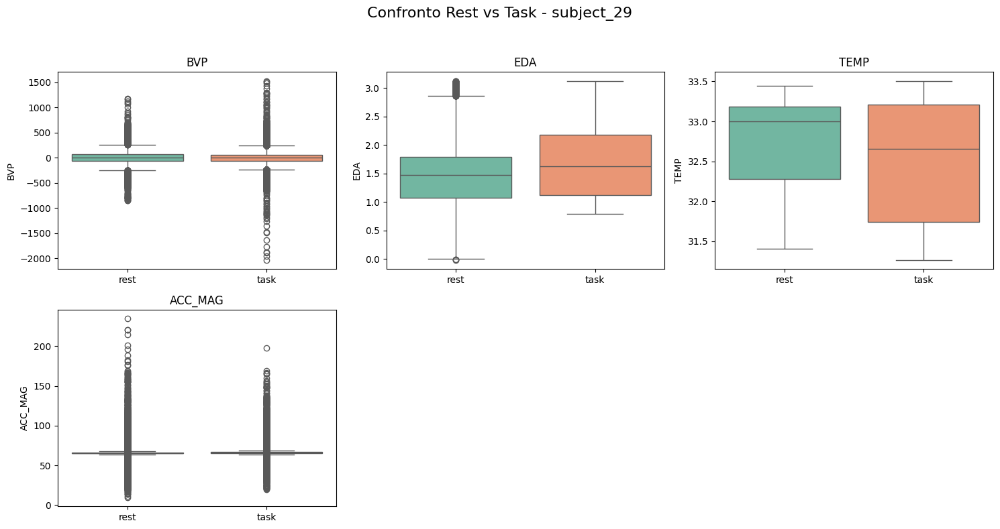

In [ ]:
# Lista dei segnali da plottare
signal_columns = ['bvp', 'eda', 'temp', 'acc_mag']
n_cols = 3  # Numero di grafici per riga

# Ciclo per soggetto
for subject in df['subject'].unique():
    df_subj = df[df['subject'] == subject].copy()

    # Crea colonna per fase raggruppata: 'rest' vs 'task'
    df_subj['phase_group'] = df_subj['protocol_phase'].apply(
          lambda x: 'rest' if x.startswith('rest') or x == 'final_protocol_pattern' else 'task'
      )

    # Setup griglia
    n_signals = len(signal_columns)
    n_rows = math.ceil(n_signals / n_cols)
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols * 5, n_rows * 4))
    fig.suptitle(f"Confronto Rest vs Task - {subject}", fontsize=16)
    axes = axes.flatten()  # Rende l'array 1D per iterazione comoda

    for i, signal in enumerate(signal_columns):
        sns.boxplot(data=df_subj, x='phase_group', y=signal, palette='Set2', ax=axes[i])
        axes[i].set_title(signal.upper())
        axes[i].set_xlabel("")
        axes[i].set_ylabel(signal.upper())

    # Nasconde eventuali subplot vuoti
    for j in range(i + 1, len(axes)):
        fig.delaxes(axes[j])

    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()

In [ ]:
def run_statistical_tests(df, signal_columns):
    """
    Esegue il test di Mann-Whitney per ciascun soggetto e segnale,
    confrontando i valori tra le fasi 'rest' e 'task'.
    """
    results = []

    for subject in df['subject'].unique():
        df_subj = df[df['subject'] == subject].copy()

        # Logica aggiornata: final_protocol_pattern trattata come rest
        df_subj['phase_group'] = df_subj['protocol_phase'].apply(
            lambda x: 'rest' if x.startswith('rest') or x == 'final_protocol_pattern' else 'task'
        )

        for signal in signal_columns:
            rest_values = df_subj[df_subj['phase_group'] == 'rest'][signal].dropna()
            task_values = df_subj[df_subj['phase_group'] == 'task'][signal].dropna()

            if len(rest_values) > 0 and len(task_values) > 0:
                stat, p = mannwhitneyu(rest_values, task_values, alternative='two-sided')
                significant = p < 0.05
            else:
                stat, p, significant = None, None, False

            results.append({
                'subject': subject,
                'signal': signal,
                'p_value': p,
                'significant': significant
            })

    return pd.DataFrame(results)

In [ ]:
signal_columns = ['bvp', 'eda', 'temp', 'acc_mag']
results_df = run_statistical_tests(df, signal_columns)
display(results_df)

,subject,signal,p_value,significant
0,subject_01,bvp,4.046290e-09,True
1,subject_01,eda,7.197476e-18,True
2,subject_01,temp,8.953908e-170,True
3,subject_01,acc_mag,7.338897e-93,True
4,subject_02,bvp,5.737015e-01,False
...,...,...,...,...
111,subject_28,acc_mag,0.000000e+00,True
112,subject_29,bvp,1.739514e-12,True
113,subject_29,eda,0.000000e+00,True
114,subject_29,temp,1.330903e-123,True


In [ ]:
# Filtra solo i test con p-value > 0.05
non_significant_df = results_df[results_df['significant'] == False]

# Visualizza solo quelli
display(non_significant_df)

,subject,signal,p_value,significant
4,subject_02,bvp,0.573701,False
12,subject_04,bvp,0.636772,False
16,subject_05,bvp,0.960769,False
28,subject_08,bvp,0.452233,False
36,subject_10,bvp,0.717287,False
39,subject_10,acc_mag,0.228888,False
44,subject_12,bvp,0.751379,False
56,subject_15,bvp,0.062579,False
60,subject_16,bvp,0.395228,False
68,subject_18,bvp,0.857820,False


In [ ]:
def assign_labels_to_dataset(df, fs=64):
    """
    Etichetta ogni record del dataset seguendo il protocollo degli autori:
    - Primi 27 minuti: pattern misto stress/rest
    - Dal 28° minuto a -5 dalla fine: stress continuo
    - Ultimi 5 minuti: pattern fisso [0, 0, 1, 0, 0]

    Restituisce il DataFrame con una colonna 'label' assegnata.
    """
    samples_per_minute = fs * 60
    labeled_data = []

    for subject in df['subject'].unique():
        df_subj = df[df['subject'] == subject].reset_index(drop=True)
        total_samples = len(df_subj)

        # Indici di separazione
        first_end = 27 * samples_per_minute
        last_start = total_samples - 5 * samples_per_minute

        labels = np.ones(total_samples, dtype=int)  # default: stress

        # Etichettatura primi 27 minuti
        first_labels = np.ones(27, dtype=int)
        rest_minutes = [0, 1, 2, 13, 14, 20, 21, 25, 26]
        for idx in rest_minutes:
            if idx < len(first_labels):
                first_labels[idx] = 0

        for i, label in enumerate(first_labels):
            start = i * samples_per_minute
            end = min((i + 1) * samples_per_minute, total_samples)
            labels[start:end] = label

        # Etichettatura ultimi 5 minuti con pattern fisso
        final_pattern = [0, 0, 1, 0, 0]
        for i, label in enumerate(final_pattern):
            start = last_start + i * samples_per_minute
            end = min(start + samples_per_minute, total_samples)
            if start < total_samples:
                labels[start:end] = label

        df_subj['label'] = labels
        labeled_data.append(df_subj)

    return pd.concat(labeled_data, ignore_index=True)

In [ ]:
df = assign_labels_to_dataset(df)
df.head()

,bvp,eda,temp,subject,protocol_phase,acc_mag,label
0,-5.081451e-15,6.160874e-15,32.680000,subject_01,rest_1,63.984373,0
1,-5.371820e-14,-2.176869e-01,32.693612,subject_01,rest_1,72.803839,0
2,-5.081451e-15,-3.885328e-01,32.704953,subject_01,rest_1,64.899923,0
3,-2.499893e-14,-5.120843e-01,32.713979,subject_01,rest_1,61.109760,0
4,2.958131e-14,-5.889338e-01,32.720702,subject_01,rest_1,65.092242,0


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4149992 entries, 0 to 4149991
Data columns (total 7 columns):
 #   Column          Dtype  
---  ------          -----  
 0   bvp             float64
 1   eda             float64
 2   temp            float64
 3   subject         object 
 4   protocol_phase  object 
 5   acc_mag         float64
 6   label           int64  
dtypes: float64(4), int64(1), object(2)
memory usage: 221.6+ MB


In [ ]:
df.describe()

,bvp,eda,temp,acc_mag,label
count,4.149992e+06,4.149992e+06,4.149992e+06,4.149992e+06,4.149992e+06
mean,-2.878704e-04,1.288284e+00,3.072690e+01,6.577183e+01,6.511608e-01
std,1.064747e+02,1.666268e+00,2.317582e+00,4.397759e+00,4.766031e-01
min,-2.028660e+03,-1.395154e+00,2.547305e+01,4.252845e+00,0.000000e+00
25%,-2.882000e+01,3.130024e-01,2.923413e+01,6.476028e+01,0.000000e+00
50%,1.810000e+00,6.492752e-01,3.098952e+01,6.558201e+01,1.000000e+00
75%,3.030000e+01,1.660052e+00,3.275977e+01,6.641697e+01,1.000000e+00
max,2.627920e+03,1.319185e+01,3.447453e+01,2.357788e+02,1.000000e+00


In [ ]:
df.head()

,bvp,eda,temp,subject,protocol_phase,acc_mag,label
0,-5.081451e-15,6.160874e-15,32.680000,subject_01,rest_1,63.984373,0
1,-5.371820e-14,-2.176869e-01,32.693612,subject_01,rest_1,72.803839,0
2,-5.081451e-15,-3.885328e-01,32.704953,subject_01,rest_1,64.899923,0
3,-2.499893e-14,-5.120843e-01,32.713979,subject_01,rest_1,61.109760,0
4,2.958131e-14,-5.889338e-01,32.720702,subject_01,rest_1,65.092242,0


In [ ]:
freq_assolute = df['label'].value_counts()
freq_relative = df['label'].value_counts(normalize=True)

frequency_table = pd.DataFrame({
    'Absolute Frequency': freq_assolute,
    'Relative Frequency': freq_relative.round(2)*100
})

frequency_table

,Absolute Frequency,Relative Frequency
label,,
1,2702312,65.0
0,1447680,35.0


In [ ]:
df.isna().sum()

,0
bvp,0
eda,0
temp,0
subject,0
protocol_phase,0
acc_mag,0
label,0


In [ ]:
def plot_segnali_per_soggetto(df, segnali = None, n_points = None):

  if segnali is None:
    segnali = ['bvp', 'eda', 'temp', 'acc_mag']

  soggetti = df['subject'].unique()

  for soggetto in soggetti:
    df_soggetto = df[df['subject'] == soggetto]
    print(f"\n Soggetto: {soggetto}")

    for segnale in segnali:

      baseline = df_soggetto[df_soggetto['label'] == 0][segnale].values
      stress = df_soggetto[df_soggetto['label'] == 1][segnale].values

      if n_points is not None:
        baseline = baseline[:n_points]
        stress = stress[:n_points]

        plt.figure(figsize=(15,3))
        plt.plot(baseline, color = 'green', label = 'Baseline', linewidth = 0.8)
        plt.plot(range(len(baseline), len(baseline)+ len(stress)), stress, color = 'red', label = 'Stress', linewidth = 0.8)
        plt.title(f"Soggetto: {soggetto} - Segnale: {segnale.upper()}", fontsize = 14)
        plt.xlabel("Campioni")
        plt.ylabel("Ampiezza")
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()


 Soggetto: subject_01


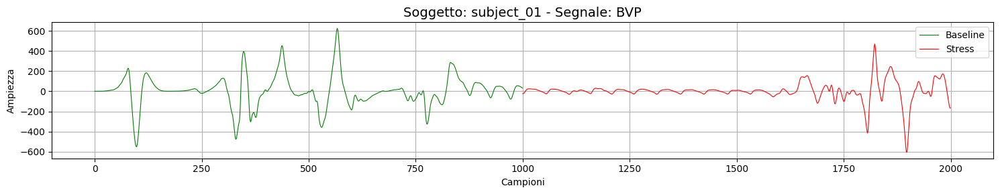

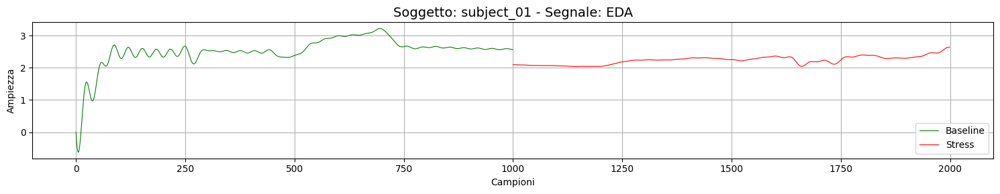

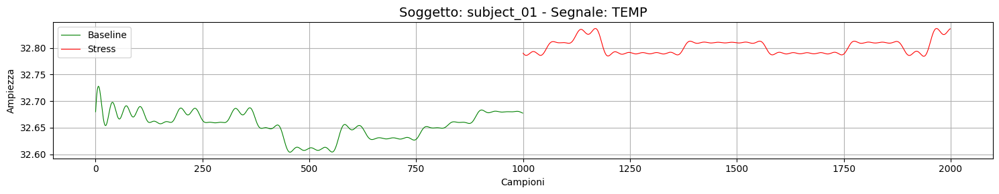

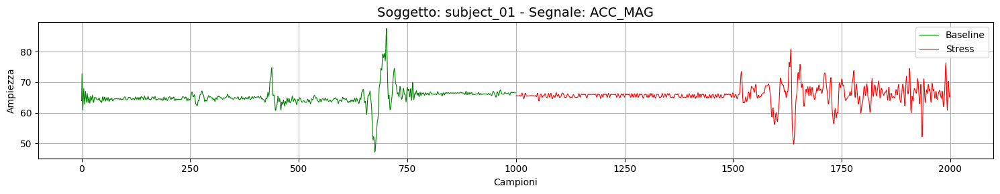


 Soggetto: subject_02


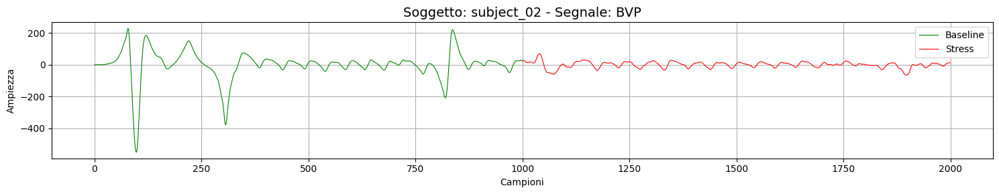

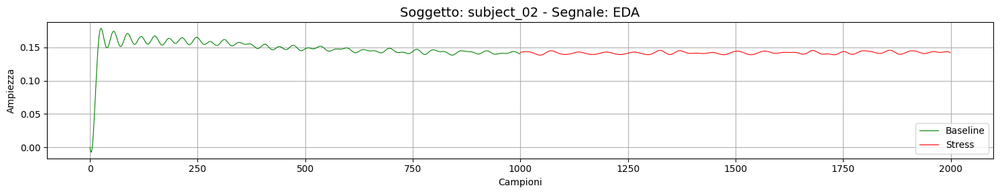

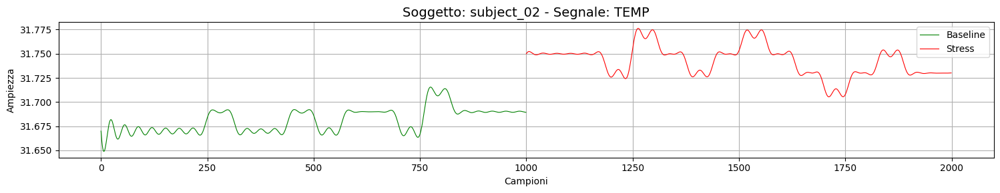

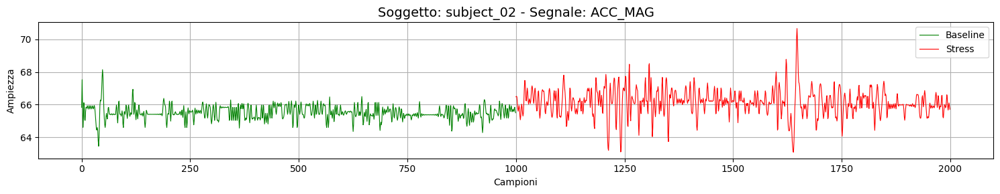


 Soggetto: subject_03


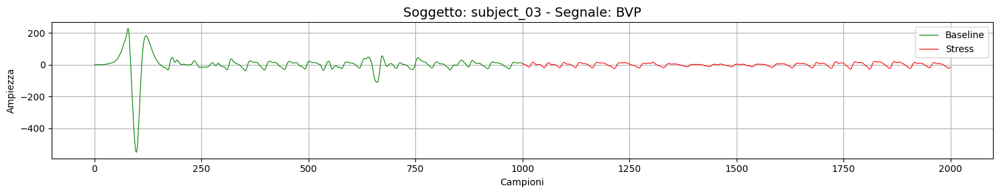

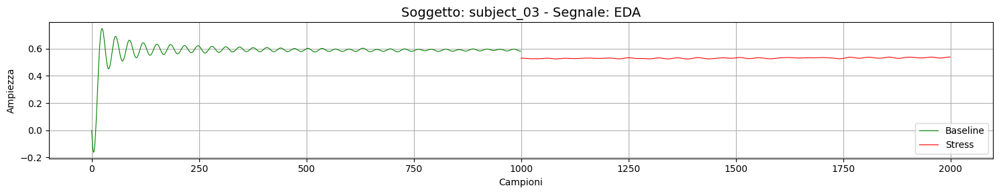

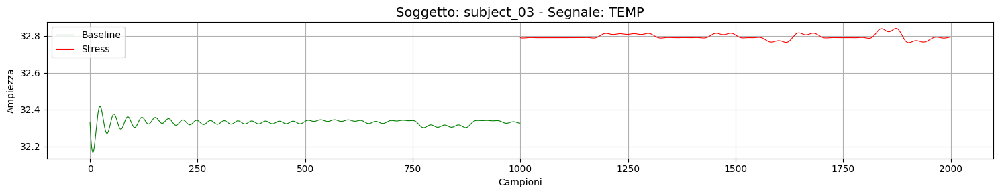

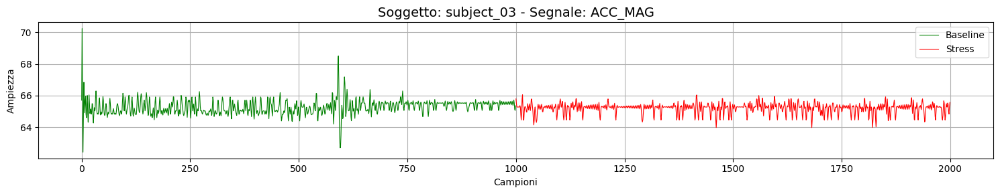


 Soggetto: subject_04


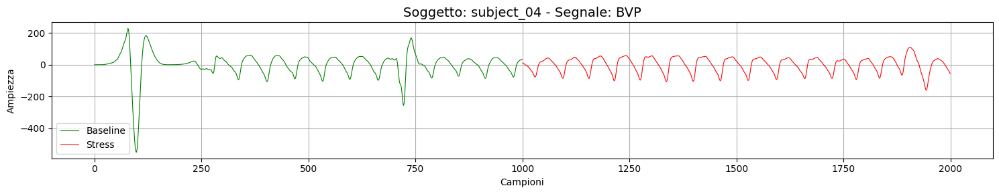

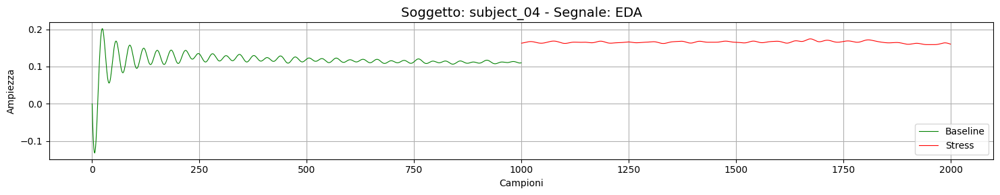

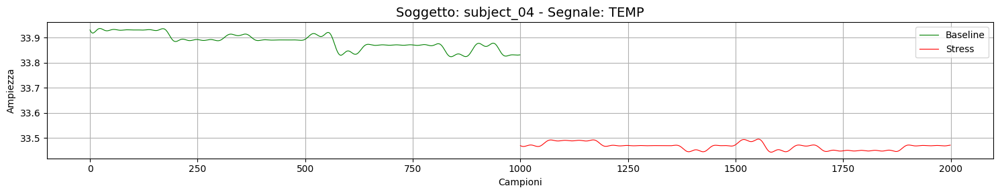

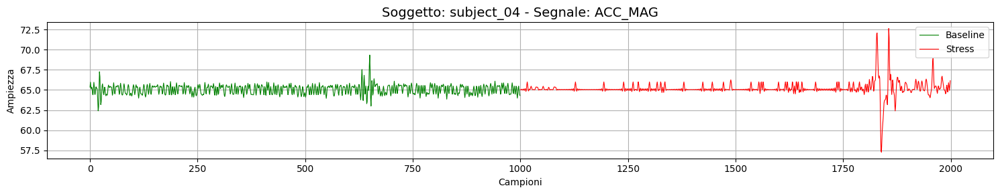


 Soggetto: subject_05


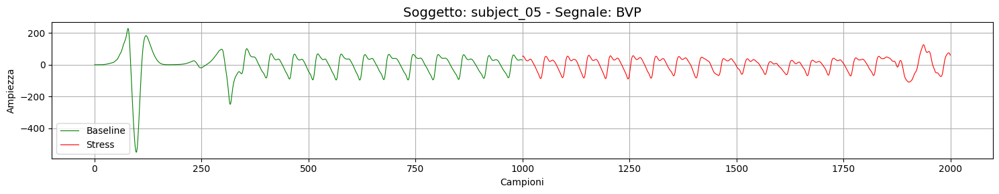

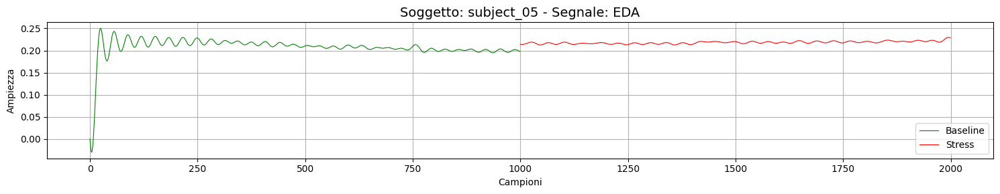

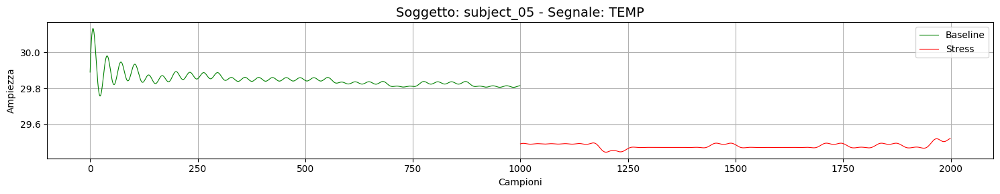

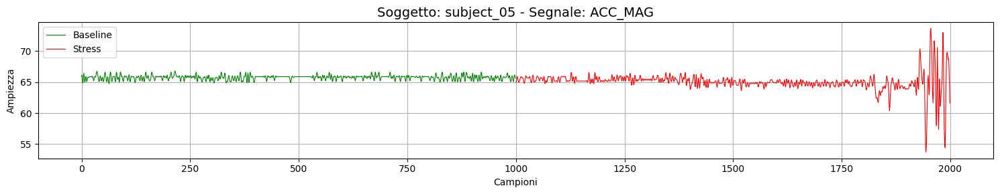


 Soggetto: subject_06


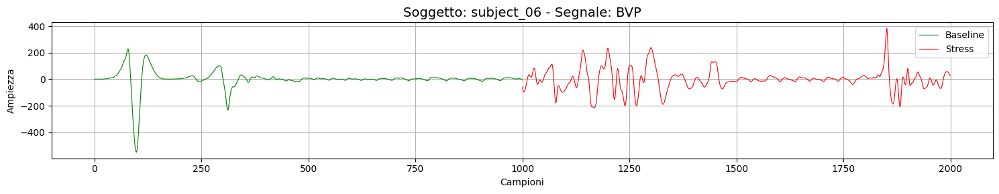

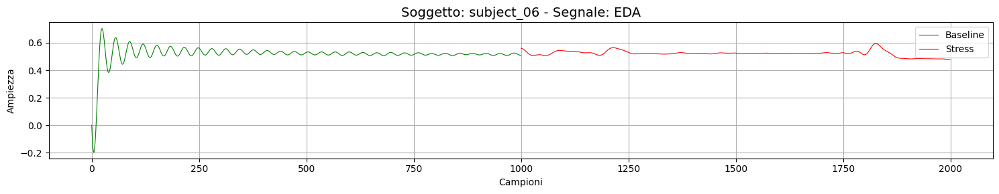

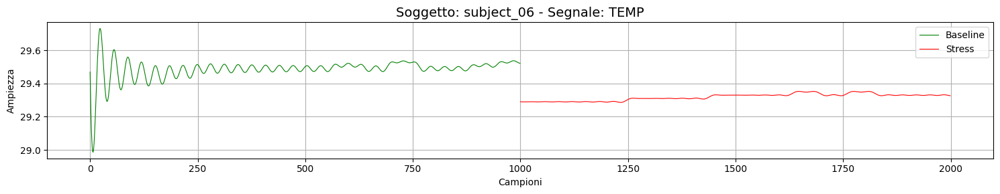

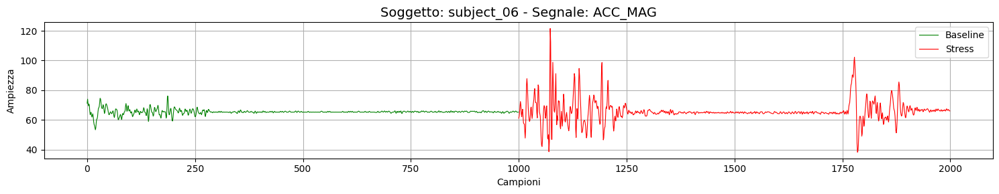


 Soggetto: subject_07


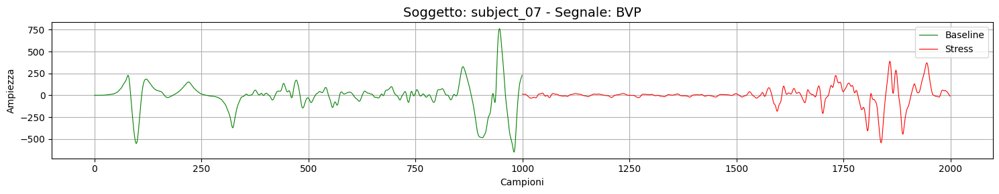

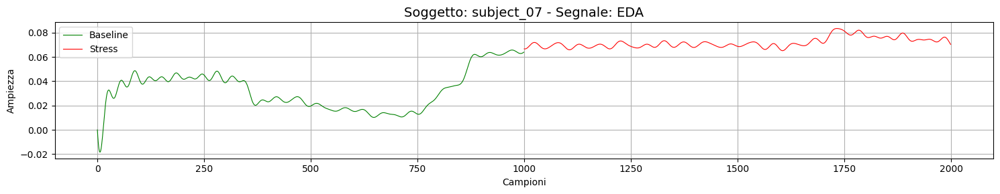

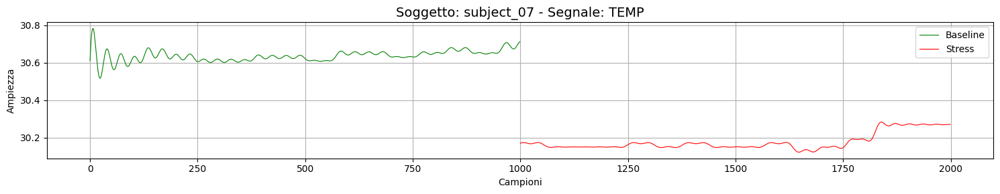

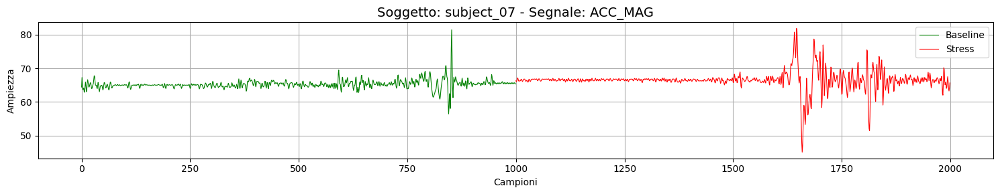


 Soggetto: subject_08


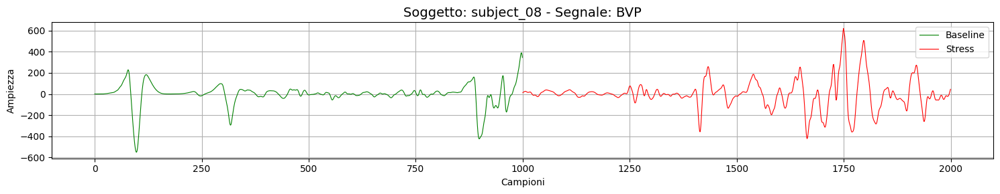

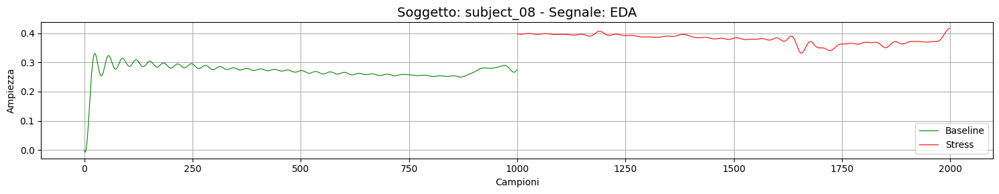

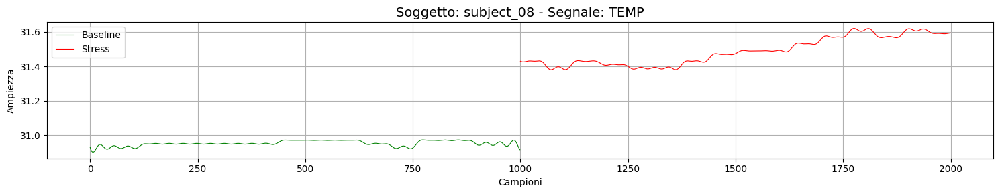

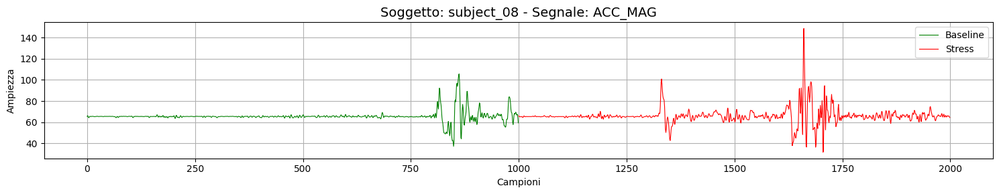


 Soggetto: subject_09


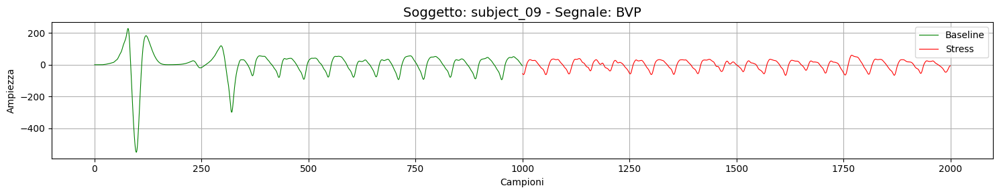

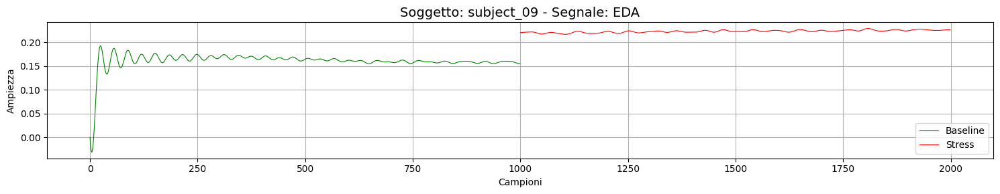

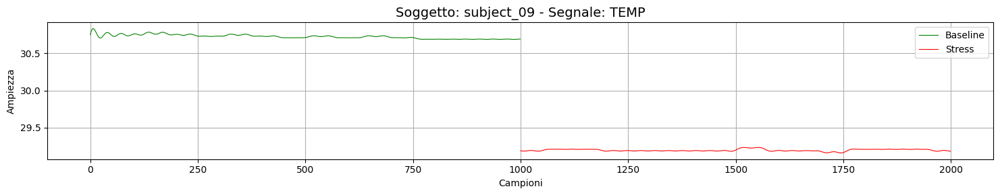

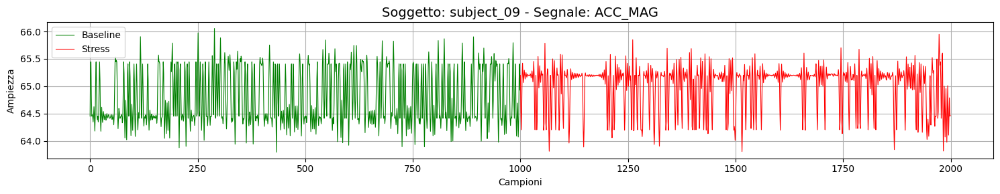


 Soggetto: subject_10


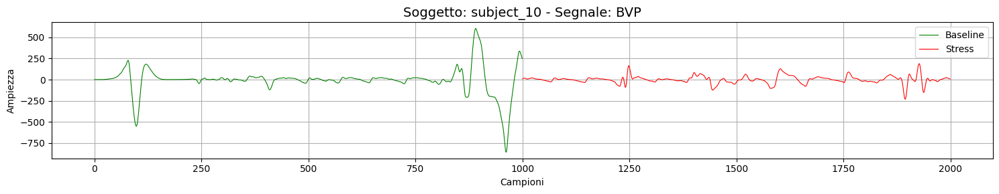

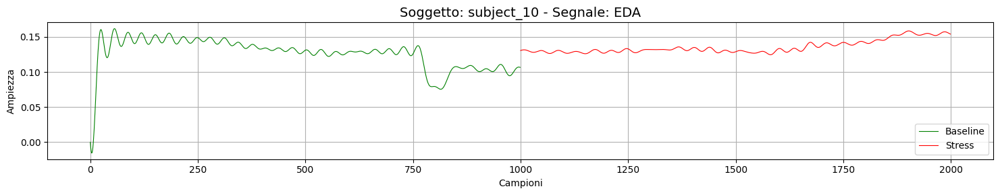

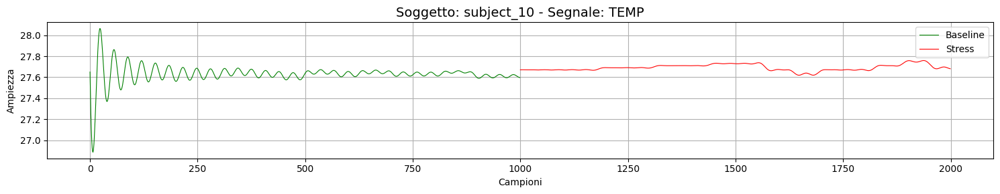

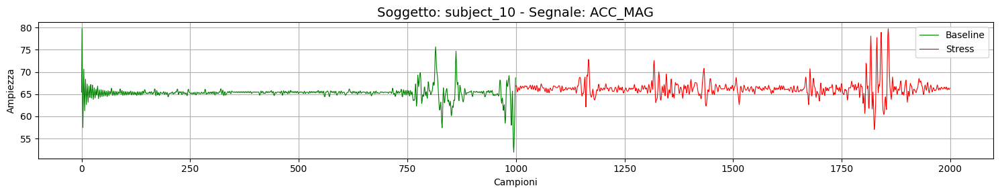


 Soggetto: subject_11


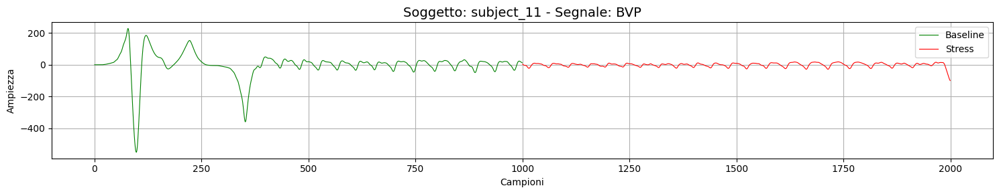

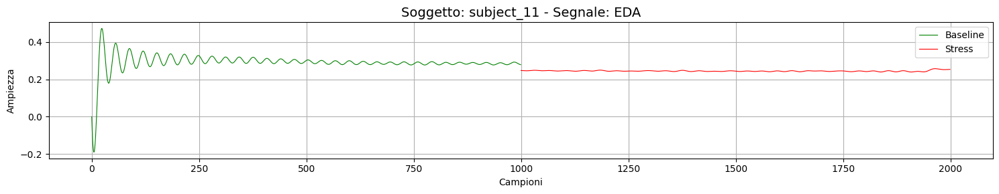

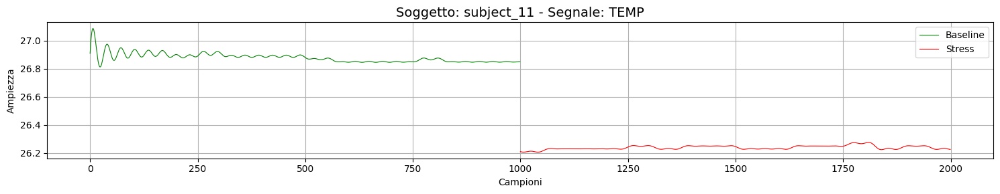

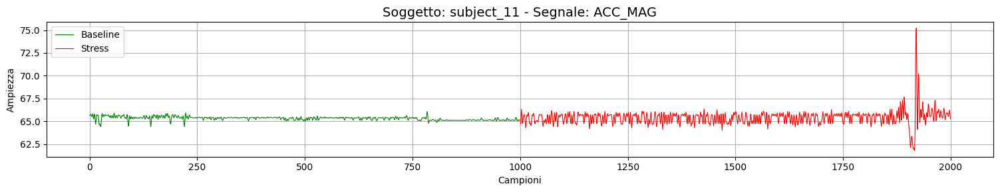


 Soggetto: subject_12


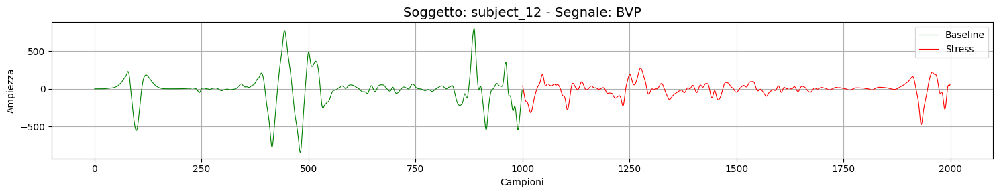

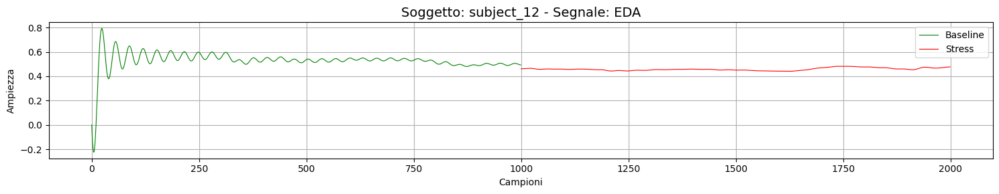

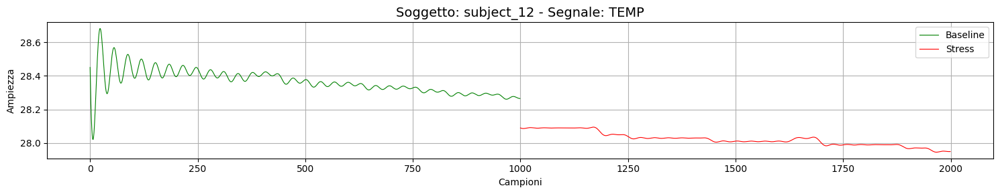

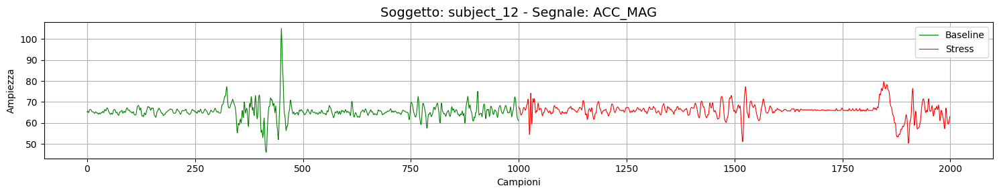


 Soggetto: subject_13


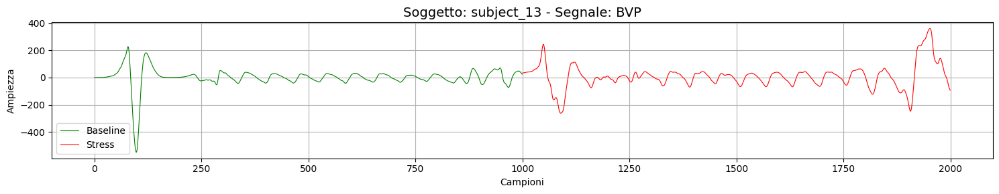

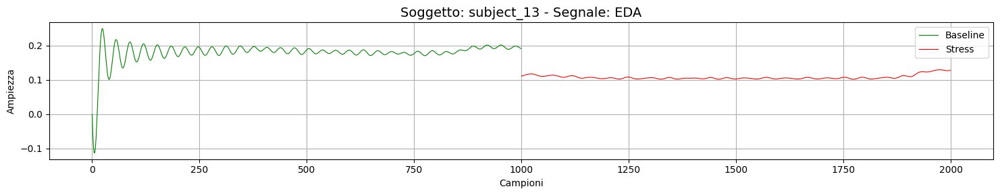

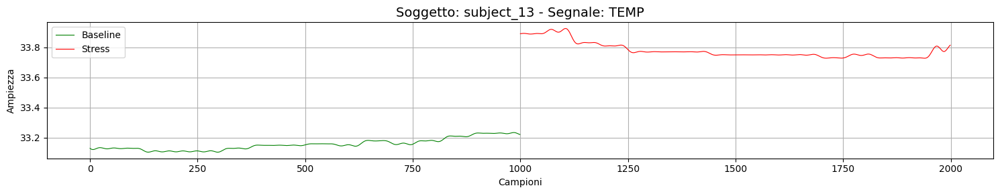

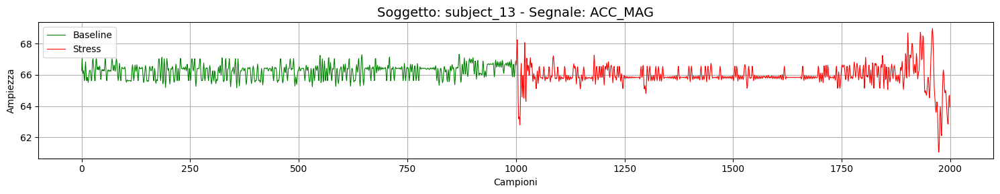


 Soggetto: subject_14


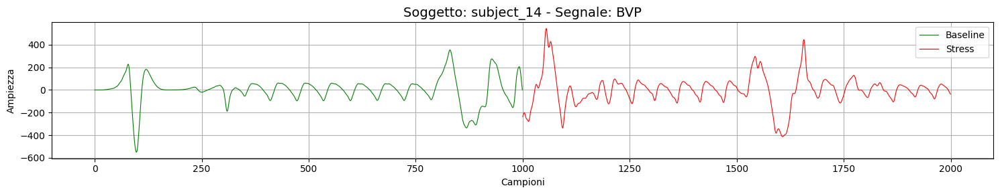

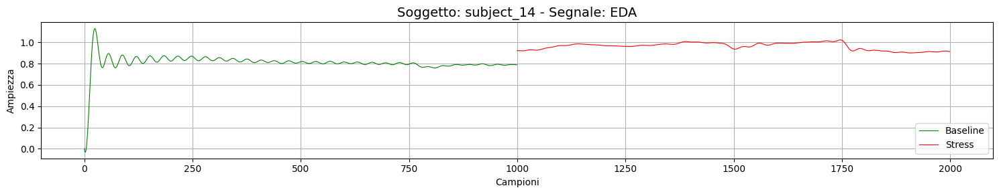

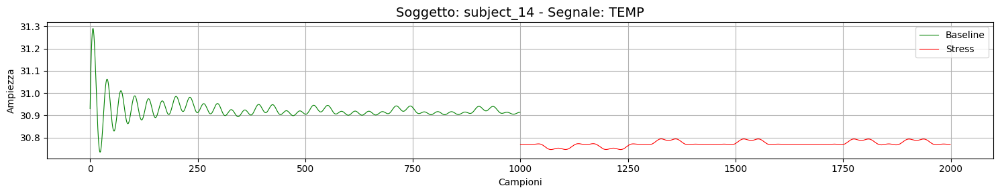

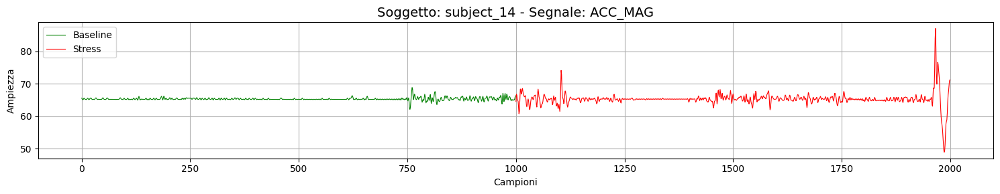


 Soggetto: subject_15


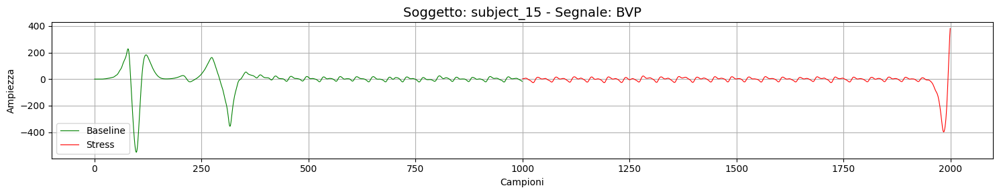

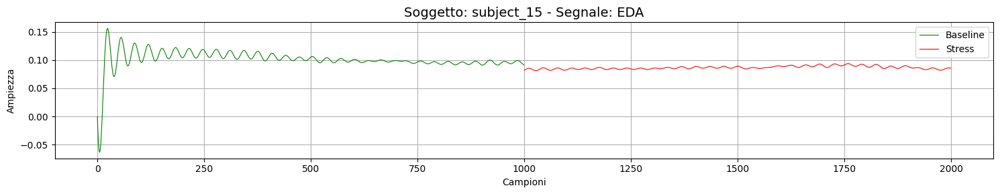

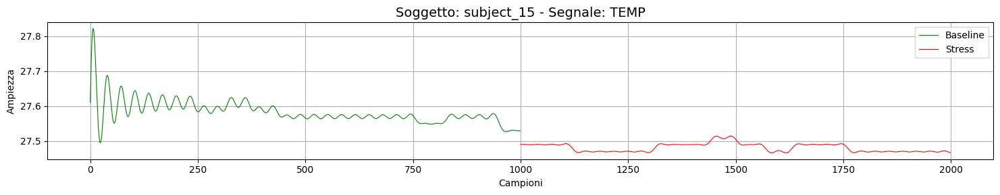

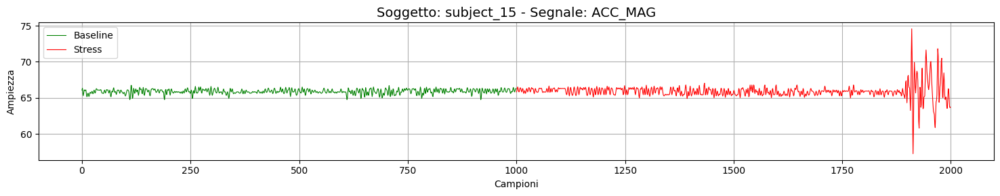


 Soggetto: subject_16


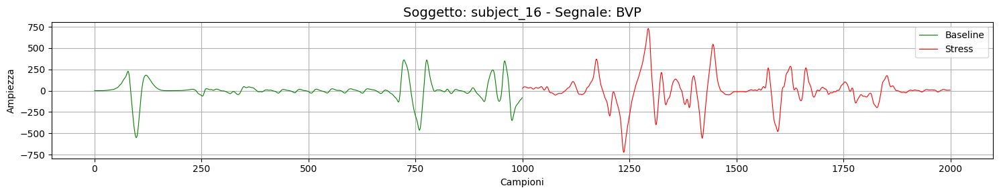

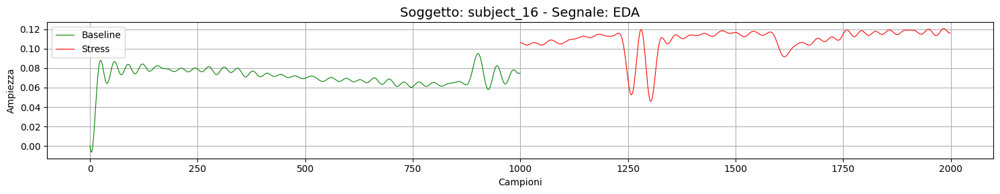

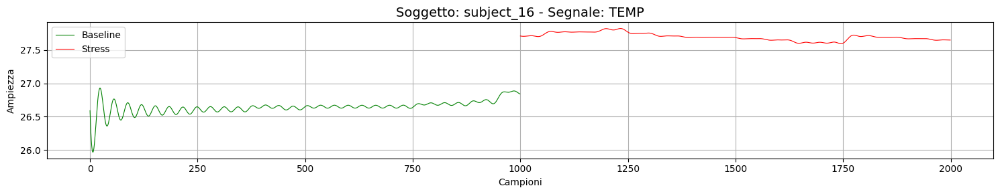

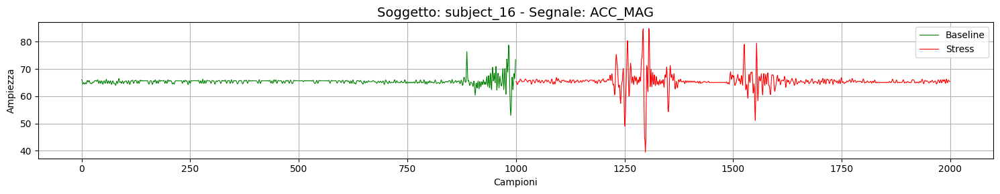


 Soggetto: subject_17


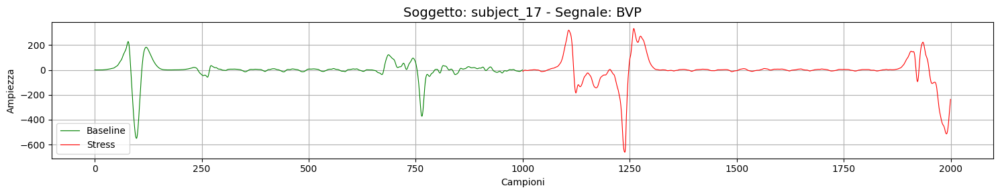

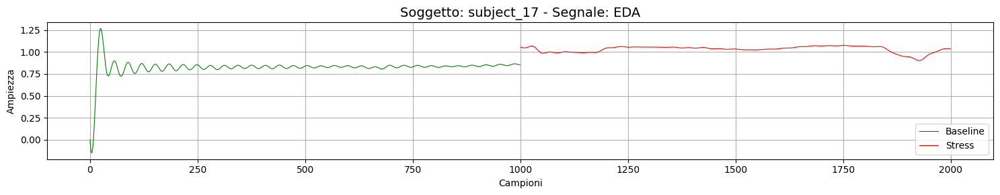

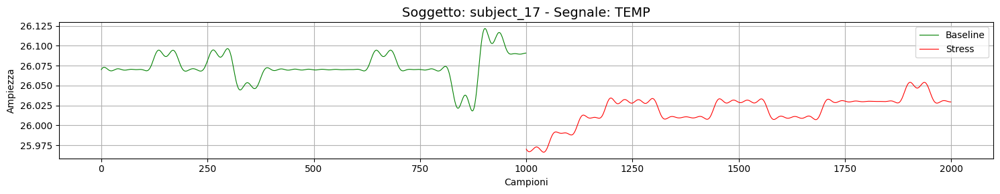

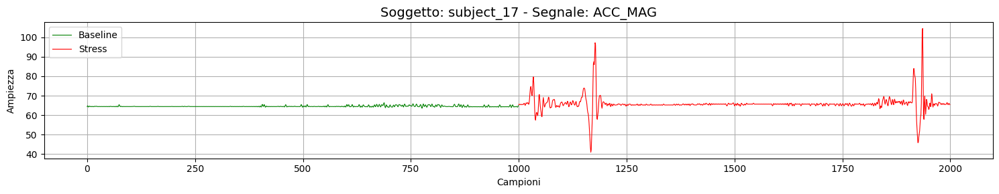


 Soggetto: subject_18


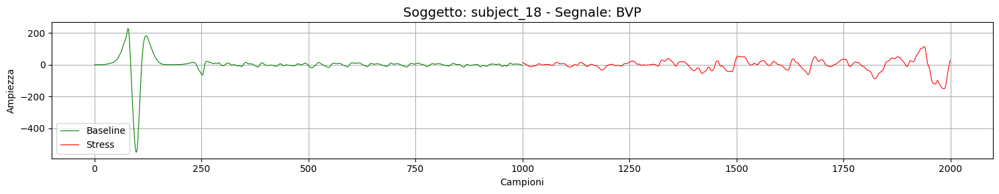

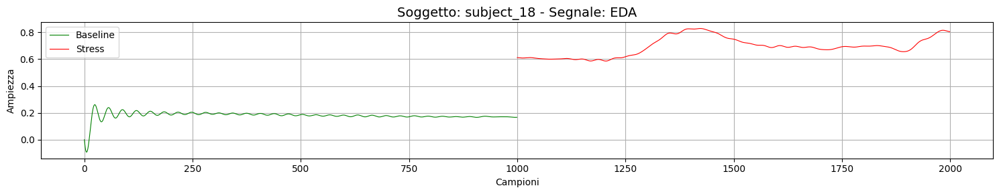

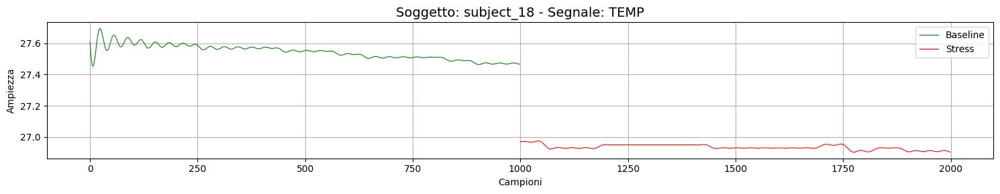

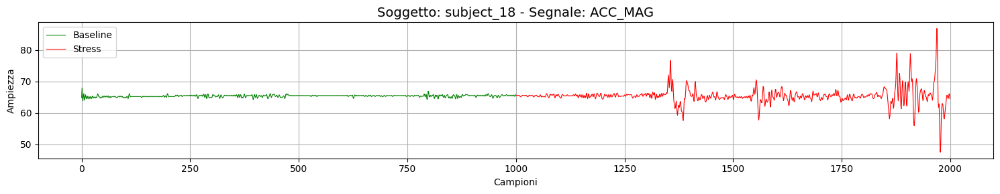


 Soggetto: subject_19


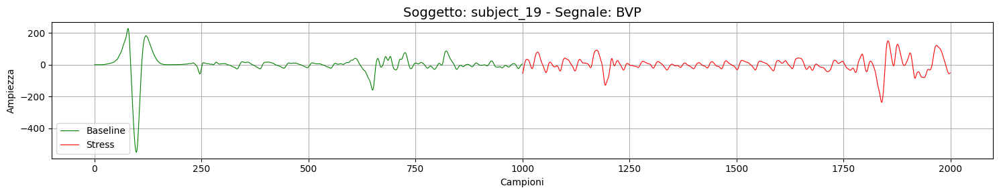

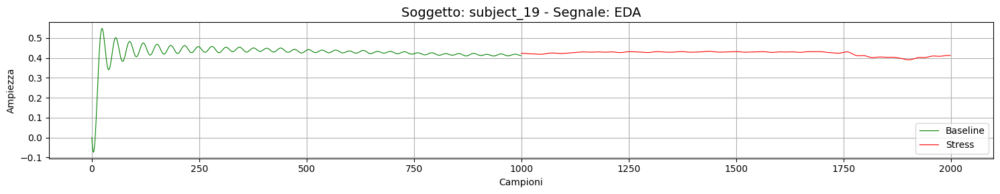

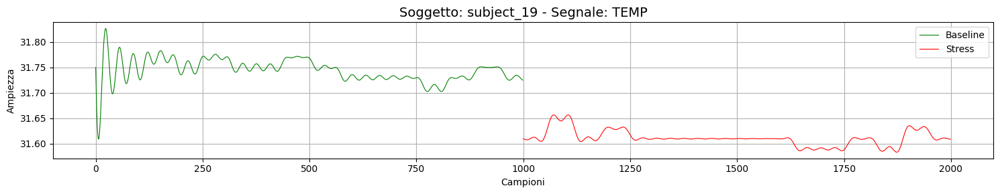

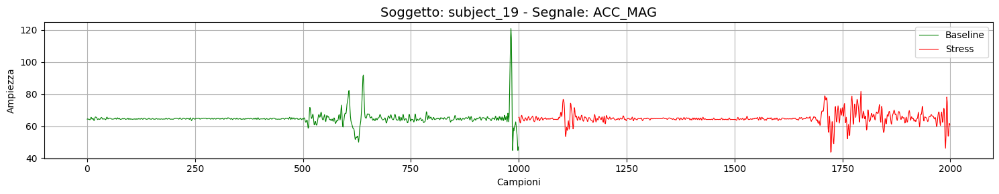


 Soggetto: subject_20


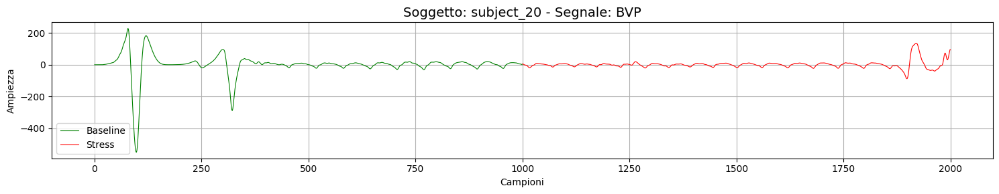

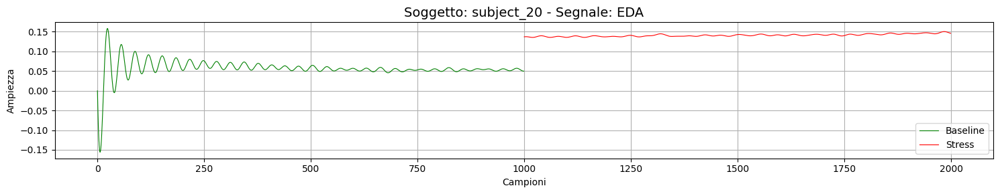

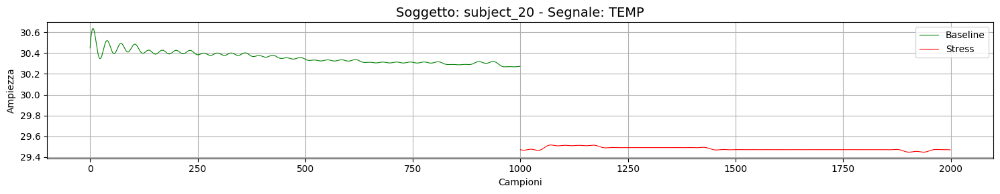

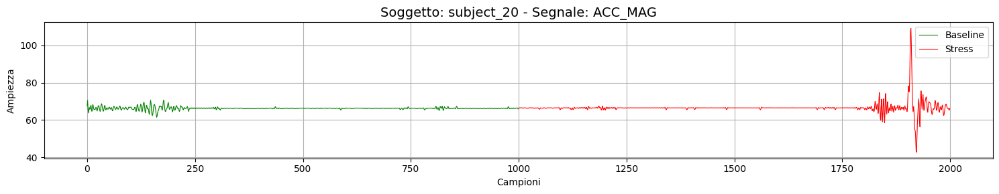


 Soggetto: subject_21


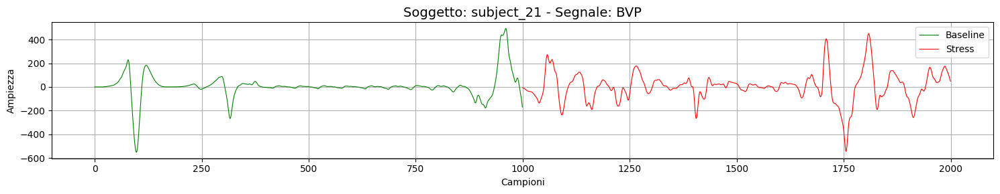

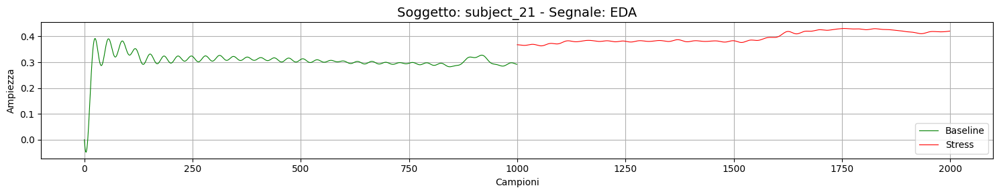

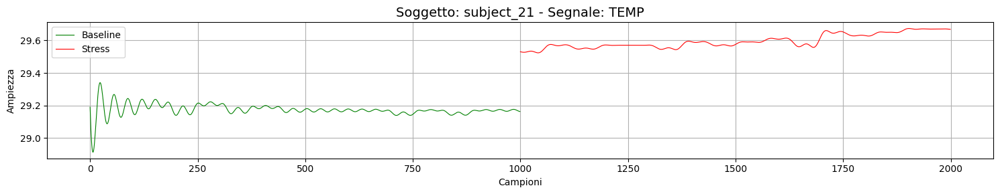

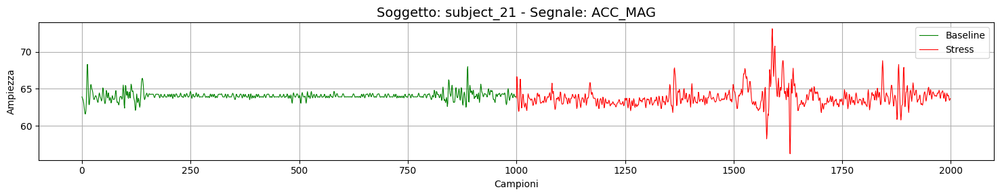


 Soggetto: subject_22


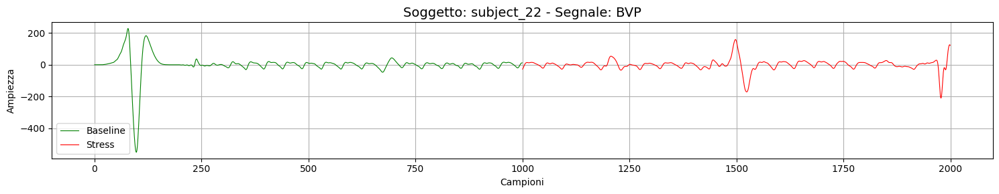

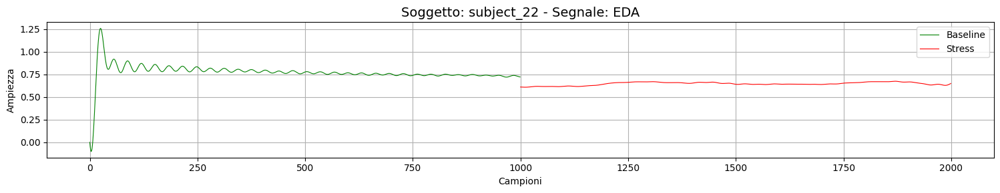

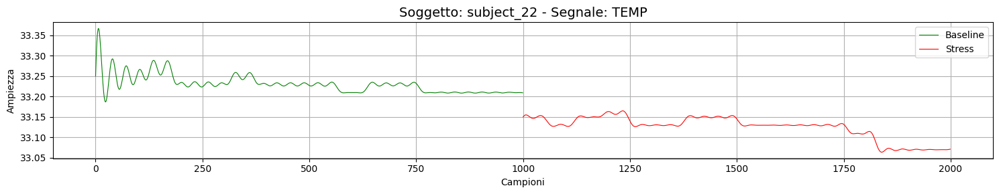

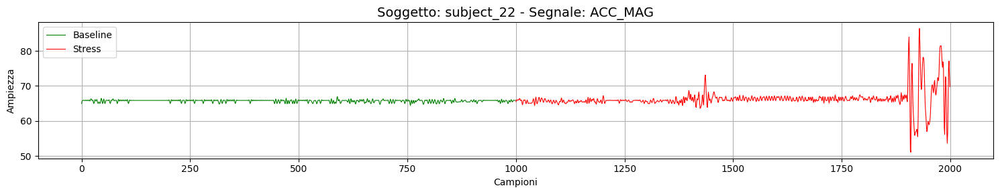


 Soggetto: subject_23


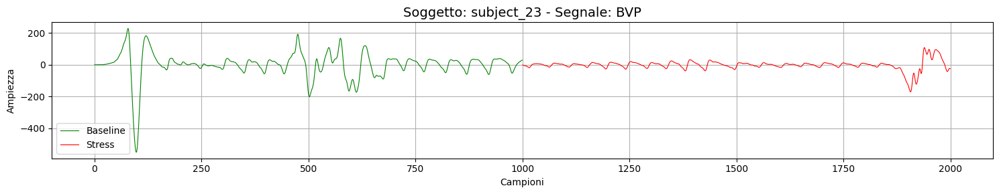

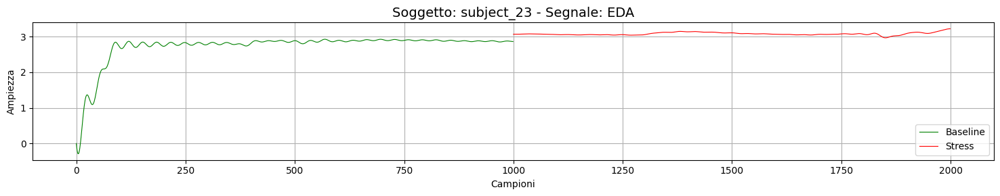

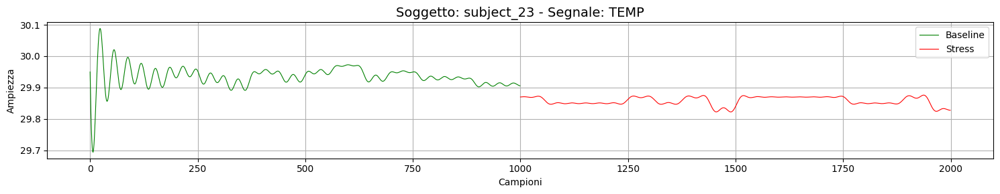

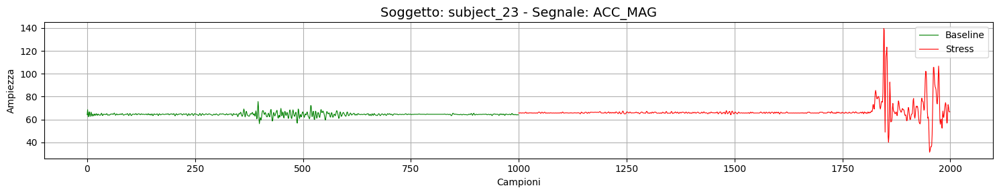


 Soggetto: subject_24


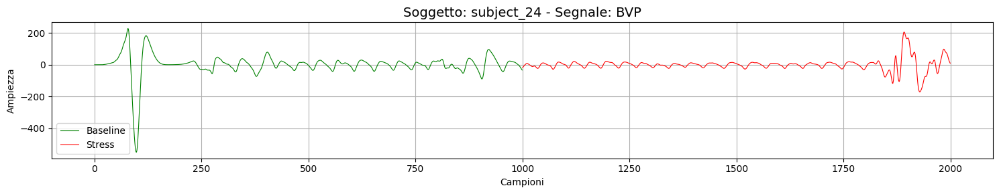

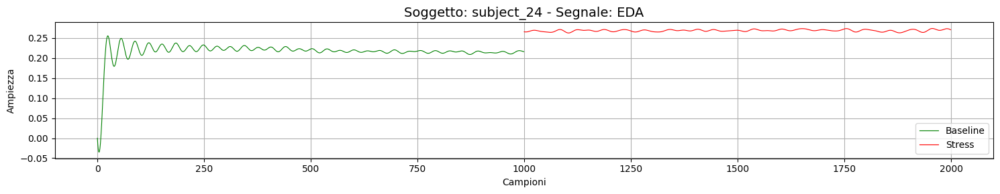

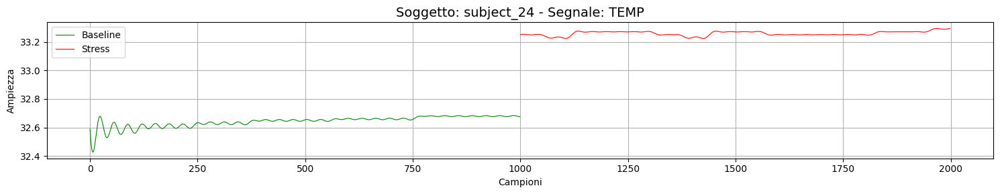

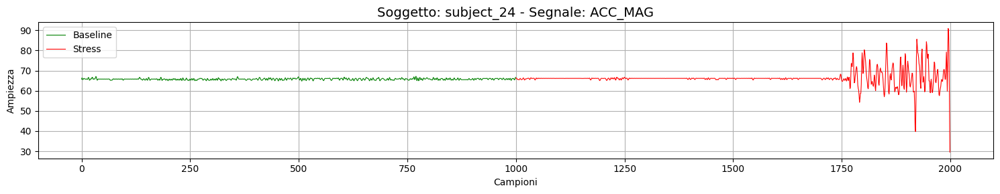


 Soggetto: subject_25


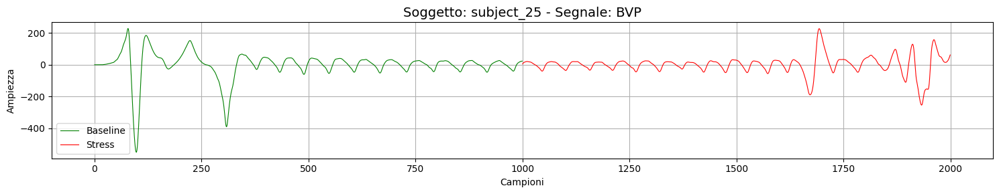

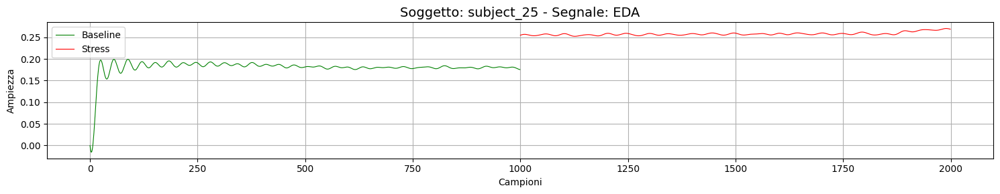

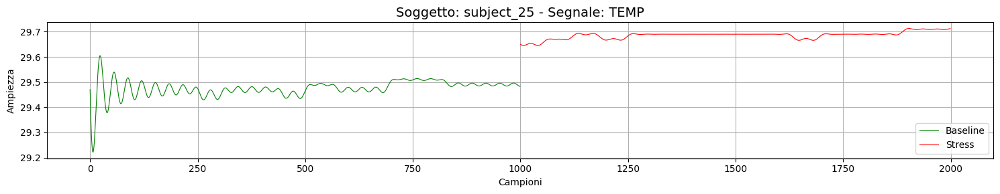

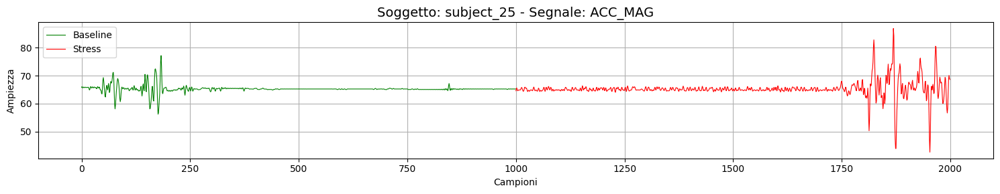


 Soggetto: subject_26


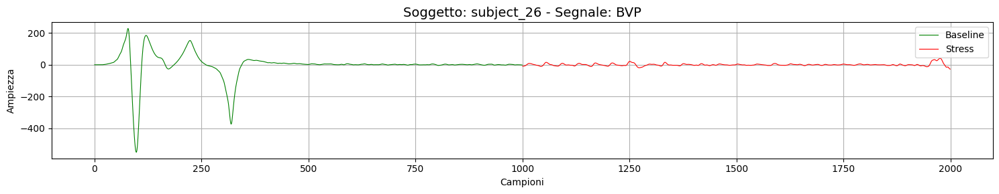

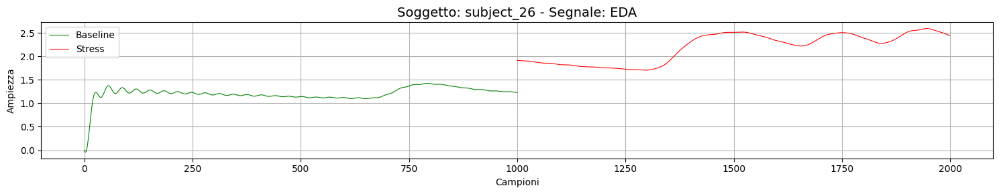

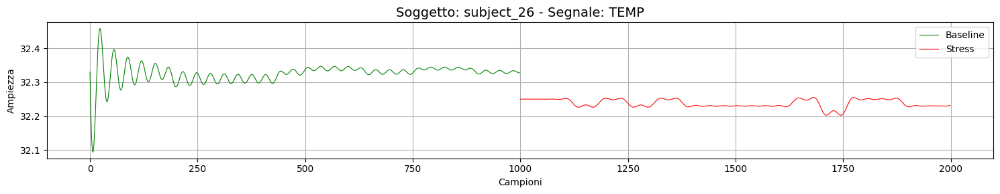

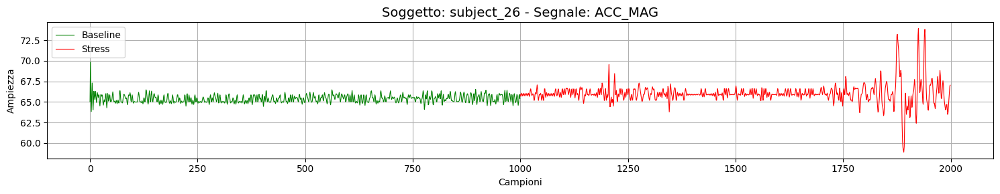


 Soggetto: subject_27


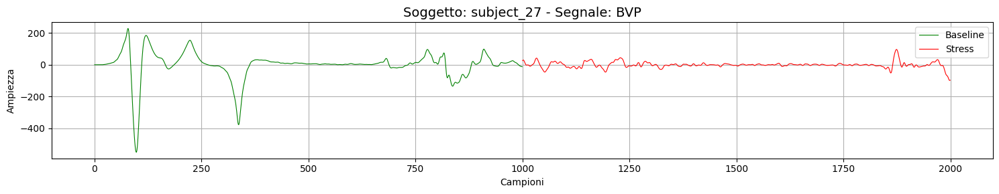

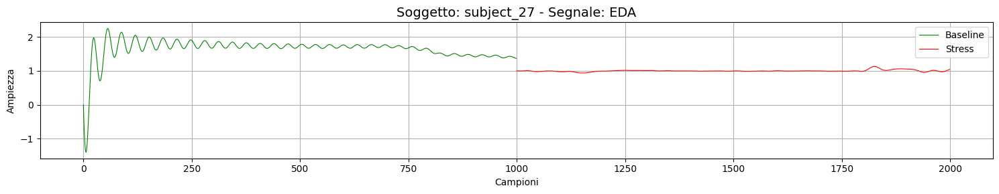

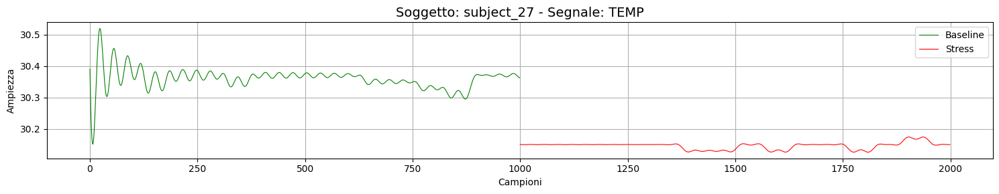

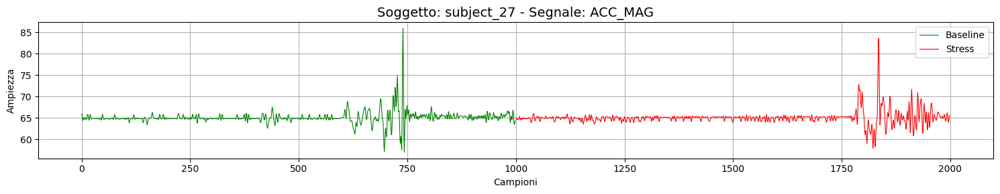


 Soggetto: subject_28


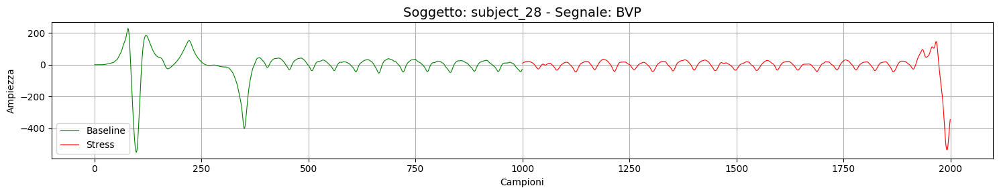

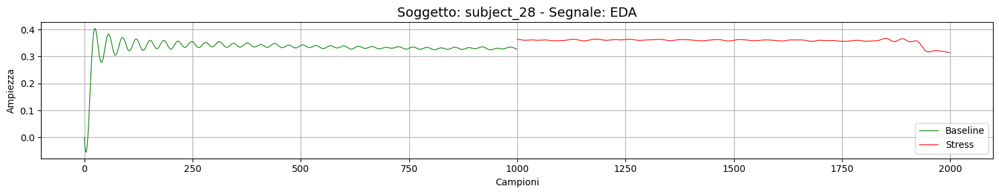

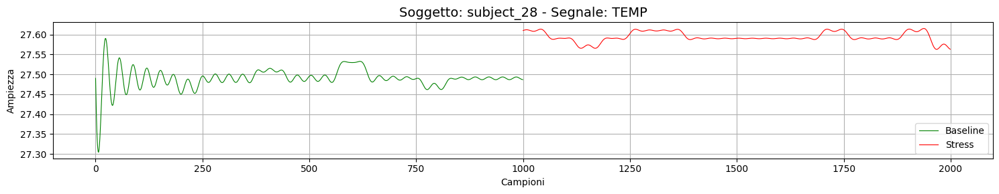

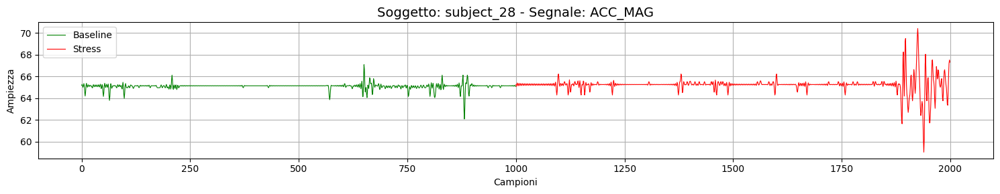


 Soggetto: subject_29


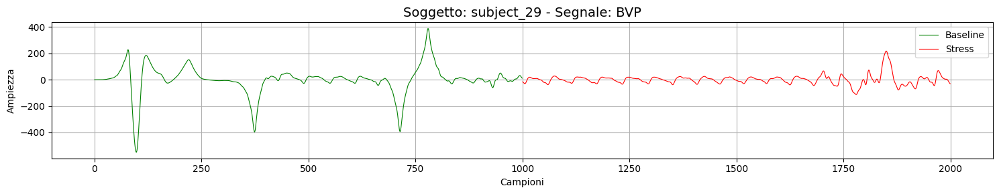

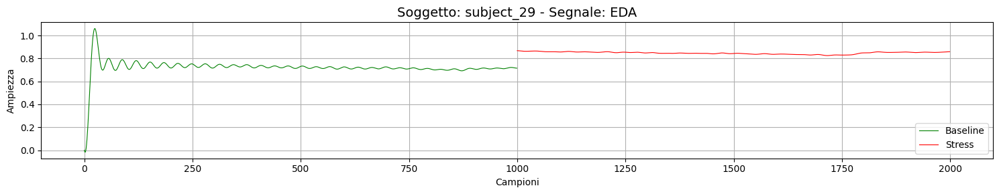

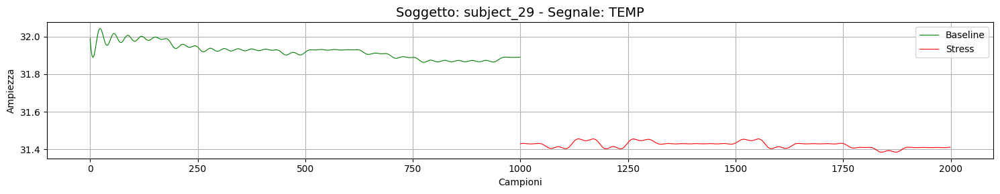

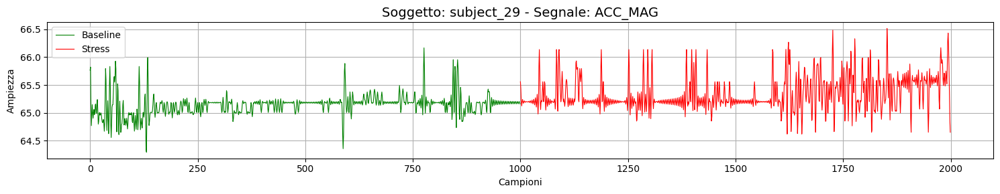

In [ ]:
plot_segnali_per_soggetto(df, n_points = 1000)

In [ ]:
pip install neurokit2

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 708.4/708.4 kB 14.1 MB/s eta 0:00:00


In [ ]:
import neurokit2 as nk

In [ ]:
ppg_raw = df["bvp"].values

fs = 64

ppg_signals, ppg_info = nk.ppg_process(ppg_raw, sampling_rate=fs)

ppg_clean = ppg_signals["PPG_Clean"]

df['bvp_clean'] = ppg_clean

In [ ]:
def plot_raw_vs_clean_from_single_df(df, raw_col, clean_col, n_points = None):

  soggetti = df['subject'].unique()

  for soggetto in soggetti:

    df_soggetto = df[df['subject'] == soggetto]

    for condizione, label in zip(['Baseline', 'Stress'], [0, 1]):
      subset = df_soggetto[df_soggetto['label'] == label]
      raw_signal = subset[raw_col].values
      clean_signal = subset[clean_col].values

      if n_points is not None:
        raw_signal = raw_signal[:n_points]
        clean_signal = clean_signal[:n_points]

      plt.figure(figsize = (15,3))
      plt.plot(raw_signal, label = 'Raw', color = 'gray', alpha=0.5)
      plt.plot(clean_signal, label = 'Clean', color = 'blue', alpha = 0.8)
      plt.title(f"Soggetto: {soggetto} - Condizione: {condizione} - Segnale: {raw_col.upper()}")
      plt.xlabel("Campioni")
      plt.ylabel("Ampiezza")
      plt.legend()
      plt.grid(True)
      plt.tight_layout()
      plt.show()

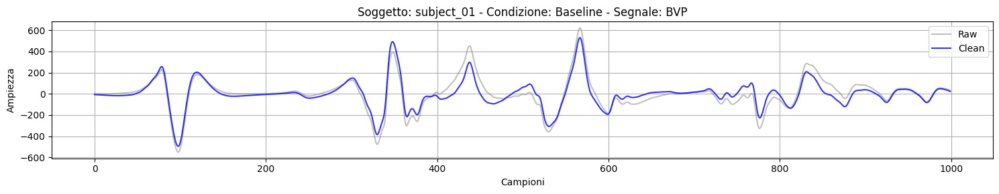

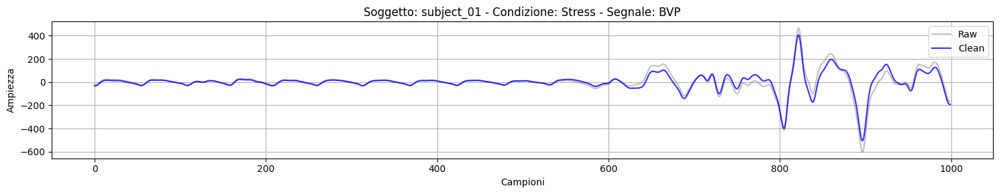

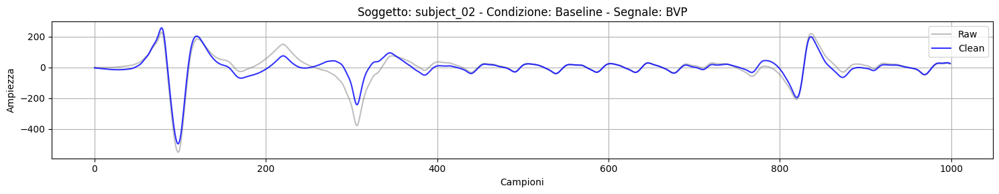

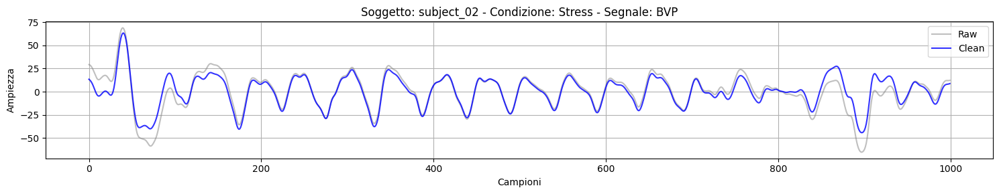

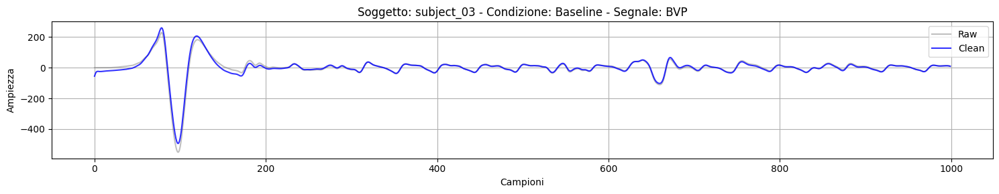

...

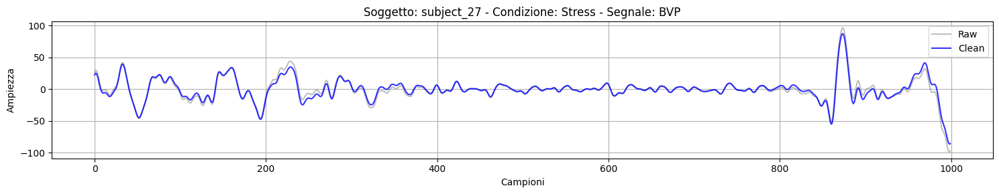

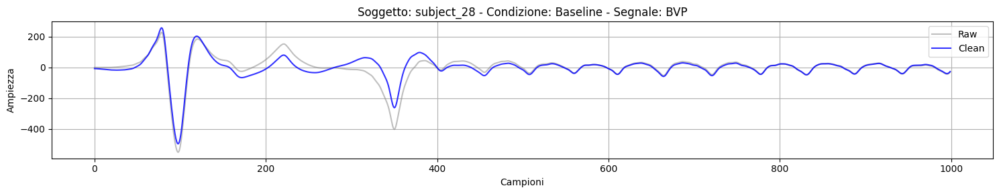

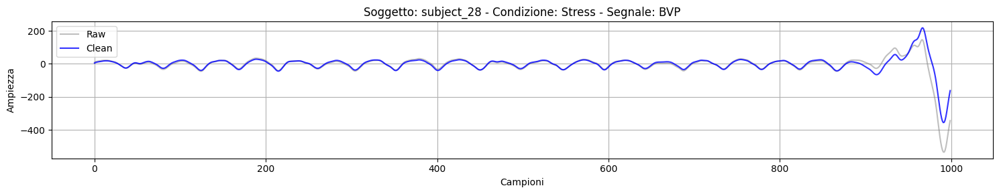

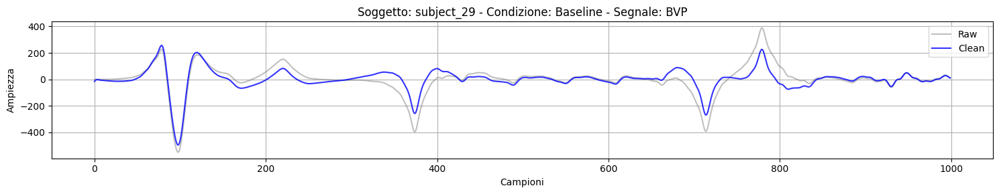

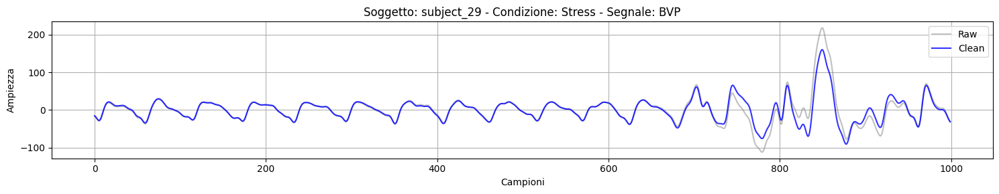

In [ ]:
plot_raw_vs_clean_from_single_df(df, 'bvp', 'bvp_clean', n_points = 1000)

In [ ]:
# Parametri
fs = 64  # frequenza di campionamento
window_sec = 60
overlap = 0.75
window_size = int(fs * window_sec)
step_size = int(window_size * (1 - overlap))

# Lista per raccogliere le feature
features_list = []

# Scorri per finestra
for start in range(0, len(df) - window_size, step_size):
    window = df["bvp_clean"].iloc[start:start + window_size].values
    labels = df["label"].iloc[start:start + window_size].values
    phases = df["protocol_phase"].iloc[start:start + window_size].values
    subject = df["subject"].iloc[start]

    # Calcola la label dominante e la sua frequenza
    counts = np.bincount(labels.astype(int), minlength=2)
    total = counts.sum()
    dominant_label = np.argmax(counts)
    dominant_ratio = counts[dominant_label] / total

    # Scarta la finestra se non ha almeno il 70% di predominanza
    if dominant_ratio < 0.7:
        continue

    label = dominant_label  # assegna la label dominante
    protocol_phase = pd.Series(phases).mode()[0]  # moda della fase

    try:
        # HRV features (NeuroKit2)
        signals, info = nk.ppg_peaks(window, sampling_rate=fs)
        hrv_features = nk.hrv(info, sampling_rate=fs, show=False)

        # --- Time-domain features manuali (Scipy) ---
        peaks, _ = find_peaks(window, distance=fs * 0.5, height=0)
        if len(peaks) < 2:
            raise ValueError("Troppi pochi picchi")

        # Amplitude
        amplitudes = window[peaks]
        amp_mean = np.mean(amplitudes)

        # Rise time
        rise_times = []
        for peak in peaks:
            if peak == 0:
                continue
            min_idx = np.argmin(window[:peak])
            rise_time = (peak - min_idx) / fs
            rise_times.append(rise_time)
        rise_time_mean = np.mean(rise_times)

        # Duration (IBI)
        ibi = np.diff(peaks) / fs
        duration_mean = np.mean(ibi)

        # Inserisci le feature nel DataFrame
        hrv_features["PPG_Amplitude"] = amp_mean
        hrv_features["PPG_RiseTime"] = rise_time_mean
        hrv_features["PPG_Duration"] = duration_mean
        hrv_features["label"] = label
        hrv_features["subject"] = subject
        hrv_features["protocol_phase"] = protocol_phase

        features_list.append(hrv_features)

    except Exception as e:
        print(f"Errore nella finestra {start}-{start + window_size}: {e}")

# Combina tutte le feature in un unico DataFrame
bvp_features = pd.concat(features_list, ignore_index=True) if features_list else pd.DataFrame()

In [ ]:
print("Shape of BVP Features:",bvp_features.shape)
bvp_features.head()

Shape of BVP Features: (3939, 89)


,HRV_MeanNN,HRV_SDNN,HRV_SDANN1,HRV_SDNNI1,HRV_SDANN2,HRV_SDNNI2,HRV_SDANN5,HRV_SDNNI5,HRV_RMSSD,HRV_SDSD,...,HRV_HFD,HRV_KFD,HRV_LZC,PPG_Amplitude,PPG_RiseTime,PPG_Duration,label,subject,protocol_phase,HRV_DFA_alpha2
0,834.375000,295.511984,NaN,NaN,NaN,NaN,NaN,NaN,343.940371,346.357296,...,1.856294,2.811185,1.313418,83.759489,30.045709,0.884943,0,subject_01,rest_1,NaN
1,812.500000,275.229741,NaN,NaN,NaN,NaN,NaN,NaN,332.696943,335.011088,...,1.863344,3.518362,1.271882,58.810724,15.740451,0.835387,0,subject_01,rest_1,NaN
2,790.962838,274.482198,NaN,NaN,NaN,NaN,NaN,NaN,363.133635,365.607000,...,1.947733,4.183921,1.090850,53.853158,26.883030,0.824384,0,subject_01,rest_1,NaN
3,832.589286,263.063669,NaN,NaN,NaN,NaN,NaN,NaN,373.202971,375.826351,...,1.998129,3.271292,1.225857,46.167827,13.347128,0.805651,0,subject_01,rest_1,NaN
4,809.289384,261.027395,NaN,NaN,NaN,NaN,NaN,NaN,384.244770,386.940270,...,2.026888,4.398421,1.187090,42.130300,18.296875,0.820530,0,subject_01,rest_1,NaN


In [ ]:
for columns in bvp_features.columns:
  print(columns)

HRV_MeanNN
HRV_SDNN
HRV_SDANN1
HRV_SDNNI1
HRV_SDANN2
HRV_SDNNI2
HRV_SDANN5
HRV_SDNNI5
HRV_RMSSD
HRV_SDSD
HRV_CVNN
HRV_CVSD
HRV_MedianNN
HRV_MadNN
HRV_MCVNN
HRV_IQRNN
HRV_SDRMSSD
HRV_Prc20NN
HRV_Prc80NN
HRV_pNN50
HRV_pNN20
HRV_MinNN
HRV_MaxNN
HRV_HTI
HRV_TINN
HRV_ULF
HRV_VLF
HRV_LF
HRV_HF
HRV_VHF
HRV_TP
HRV_LFHF
HRV_LFn
HRV_HFn
HRV_LnHF
HRV_SD1
HRV_SD2
HRV_SD1SD2
HRV_S
HRV_CSI
HRV_CVI
HRV_CSI_Modified
HRV_PIP
HRV_IALS
HRV_PSS
HRV_PAS
HRV_GI
HRV_SI
HRV_AI
HRV_PI
HRV_C1d
HRV_C1a
HRV_SD1d
HRV_SD1a
HRV_C2d
HRV_C2a
HRV_SD2d
HRV_SD2a
HRV_Cd
HRV_Ca
HRV_SDNNd
HRV_SDNNa
HRV_DFA_alpha1
HRV_MFDFA_alpha1_Width
HRV_MFDFA_alpha1_Peak
HRV_MFDFA_alpha1_Mean
HRV_MFDFA_alpha1_Max
HRV_MFDFA_alpha1_Delta
HRV_MFDFA_alpha1_Asymmetry
HRV_MFDFA_alpha1_Fluctuation
HRV_MFDFA_alpha1_Increment
HRV_ApEn
HRV_SampEn
HRV_ShanEn
HRV_FuzzyEn
HRV_MSEn
HRV_CMSEn
HRV_RCMSEn
HRV_CD
HRV_HFD
HRV_KFD
HRV_LZC
PPG_Amplitude
PPG_RiseTime
PPG_Duration
label
subject
protocol_phase
HRV_DFA_alpha2


In [ ]:
bvp_features['label'].value_counts()

,count
label,
1,2625
0,1314


In [ ]:
bvp_features.groupby(['subject', 'label']).size().unstack(fill_value=0)

label,0,1
subject,,
subject_01,47,110
subject_02,47,100
subject_03,46,80
subject_04,43,80
subject_05,46,80
subject_06,43,84
subject_07,47,86
subject_08,47,91
subject_09,47,91


In [ ]:
bvp_features = bvp_features.replace([np.inf, -np.inf], np.nan)

In [ ]:
bvp_features.isna().sum()

,0
HRV_MeanNN,0
HRV_SDNN,0
HRV_SDANN1,3939
HRV_SDNNI1,3939
HRV_SDANN2,3939
...,...
PPG_Duration,0
label,0
subject,0
protocol_phase,0


In [ ]:
def drop_columns_with_nans(df, threshold=0.5):

    nan_ratio = df.isna().mean()
    columns_to_keep = nan_ratio[nan_ratio <= threshold].index
    return df[columns_to_keep]

In [ ]:
bvp_features = drop_columns_with_nans(bvp_features)

In [ ]:
sum(bvp_features.isna().sum())

175

In [ ]:
bvp_features = bvp_features.fillna(bvp_features.median(numeric_only=True))

In [ ]:
sum(bvp_features.isna().sum())

0

In [ ]:
def drop_highly_correlated_features(df, threshold=0.8, exclude_cols=['label', 'subject', 'protocol_phase']):

    df_corr = df.drop(columns=exclude_cols)
    corr_matrix = df_corr.corr().abs()

    upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(bool))

    to_drop = [column for column in upper.columns if any(upper[column] > threshold)]

    df_reduced = df.drop(columns=to_drop)

    for col in exclude_cols:
        if col in df.columns and col not in df_reduced.columns:
            df_reduced[col] = df[col]

    return df_reduced, to_drop

In [ ]:
bvp_features, removed_cols = drop_highly_correlated_features(bvp_features, exclude_cols=['label', 'subject', 'protocol_phase'])

print("Colonne rimosse:", removed_cols)
print("Dimensione dataset:", bvp_features.shape)

Colonne rimosse: ['HRV_SDNN', 'HRV_RMSSD', 'HRV_SDSD', 'HRV_CVNN', 'HRV_CVSD', 'HRV_MCVNN', 'HRV_Prc80NN', 'HRV_pNN20', 'HRV_MaxNN', 'HRV_TP', 'HRV_HFn', 'HRV_SD1', 'HRV_SD2', 'HRV_SD1SD2', 'HRV_S', 'HRV_CSI', 'HRV_CVI', 'HRV_CSI_Modified', 'HRV_IALS', 'HRV_PSS', 'HRV_AI', 'HRV_C1a', 'HRV_SD1d', 'HRV_SD1a', 'HRV_C2a', 'HRV_SD2d', 'HRV_SD2a', 'HRV_Cd', 'HRV_Ca', 'HRV_SDNNd', 'HRV_SDNNa', 'HRV_MFDFA_alpha1_Delta', 'HRV_MFDFA_alpha1_Asymmetry', 'HRV_MFDFA_alpha1_Increment', 'HRV_ShanEn', 'HRV_RCMSEn']
Dimensione dataset: (3939, 44)


In [ ]:
def plot_numerical_features(df, label_col="label"):

    numerical_cols = df.select_dtypes(include='number').columns.drop(label_col, errors='ignore')

    for col in numerical_cols:
        fig, axes = plt.subplots(1, 3, figsize=(18, 6))

        mean = df[col].mean()
        median = df[col].median()
        std_dev = df[col].std()
        iqr = df[col].quantile(0.75) - df[col].quantile(0.25)
        skewness = stats.skew(df[col].dropna())
        kurt = stats.kurtosis(df[col].dropna())

        sns.histplot(df[col], bins=50, kde=True, ax=axes[0], color='steelblue')
        axes[0].set_title(f"Distribution of {col}")
        axes[0].set_ylabel("Density")

        sns.boxplot(y=df[col], ax=axes[1], color='steelblue')
        axes[1].set_title(f"Boxplot of {col}")

        stats.probplot(df[col].dropna(), dist="norm", plot=axes[2])
        axes[2].set_title(f"QQ-plot of {col}")

        stat_text = (
            f"Mean: {mean:.2f}\n"
            f"Median: {median:.2f}\n"
            f"SD: {std_dev:.2f}\n"
            f"IQR: {iqr:.2f}\n"
            f"Skewness: {skewness:.2f}\n"
            f"Kurtosis: {kurt:.2f}"
        )

        axes[0].text(
            0.02, 0.98, stat_text, transform=axes[0].transAxes,
            fontsize=10, verticalalignment='top',
            bbox=dict(boxstyle="round,pad=0.3", edgecolor="black", facecolor="lightgrey")
        )

        plt.tight_layout()
        plt.show()

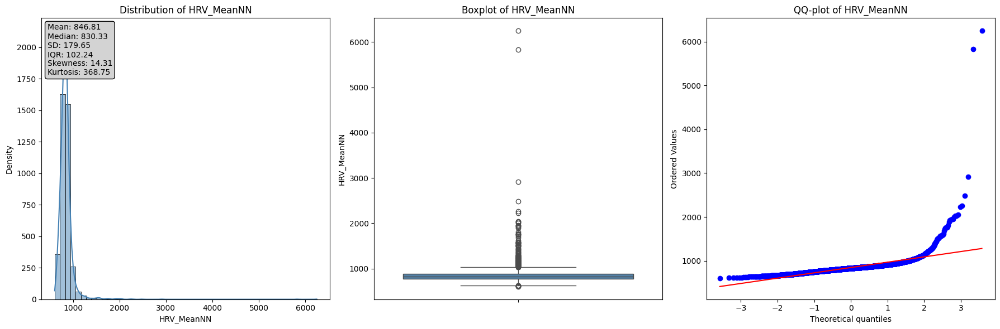

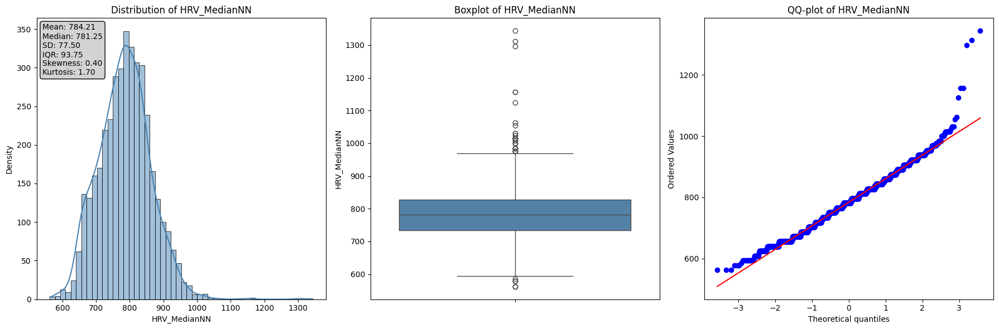

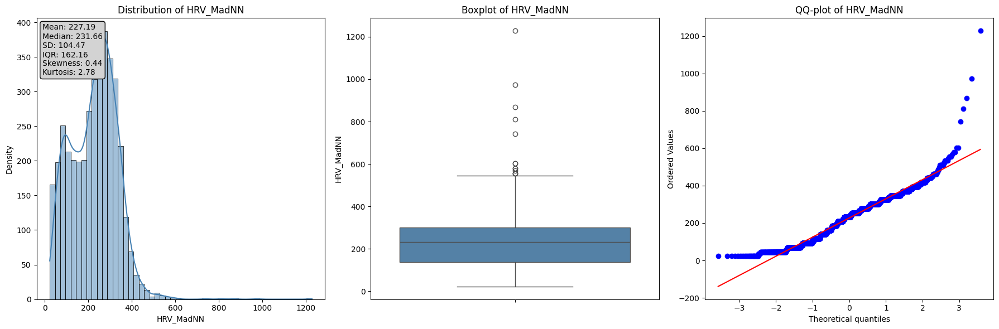

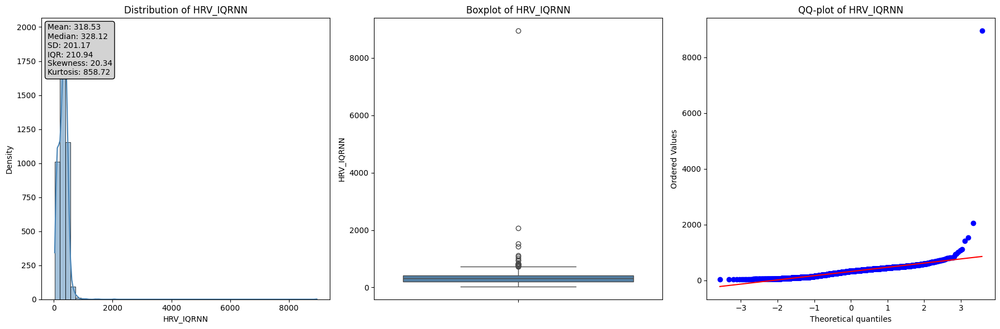

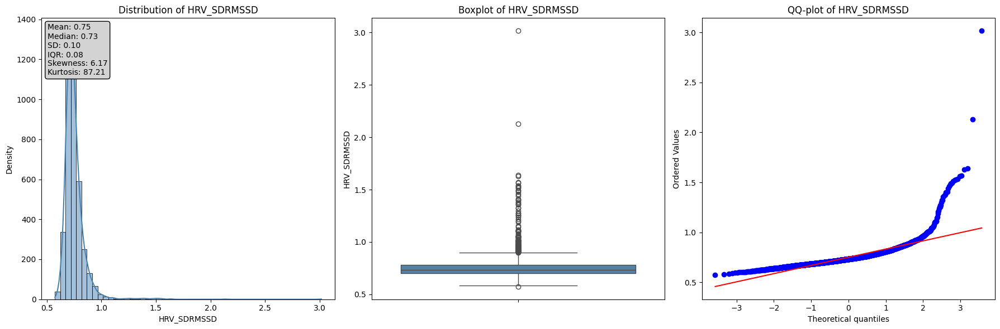

...

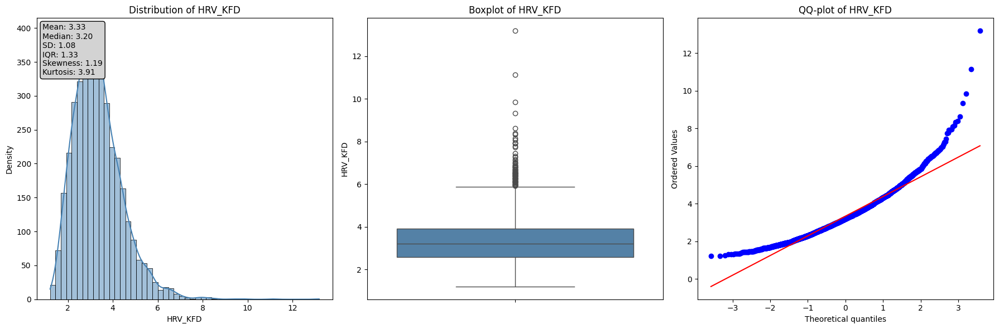

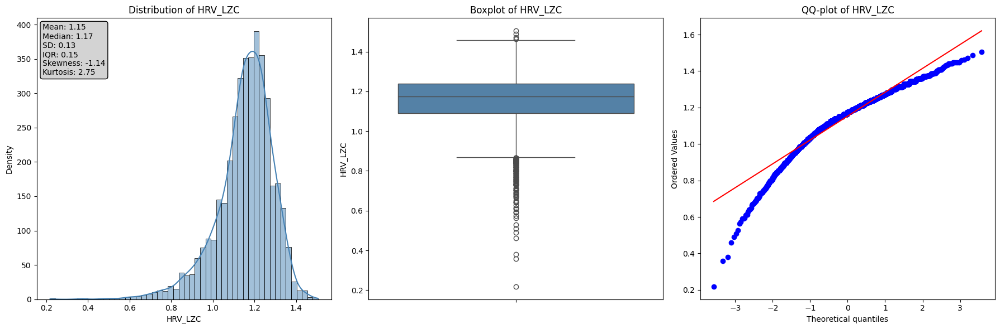

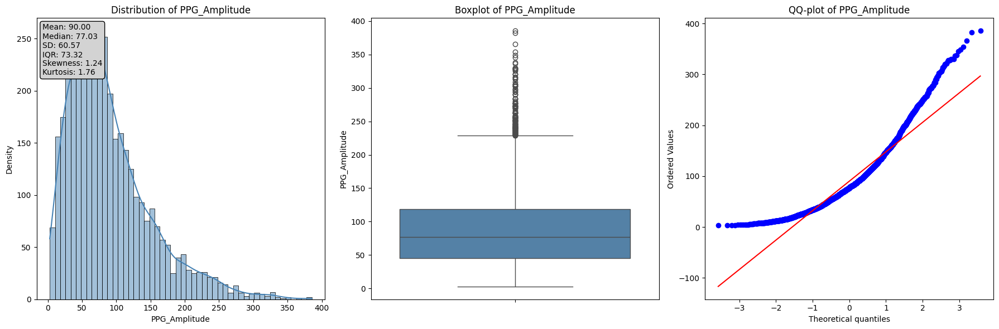

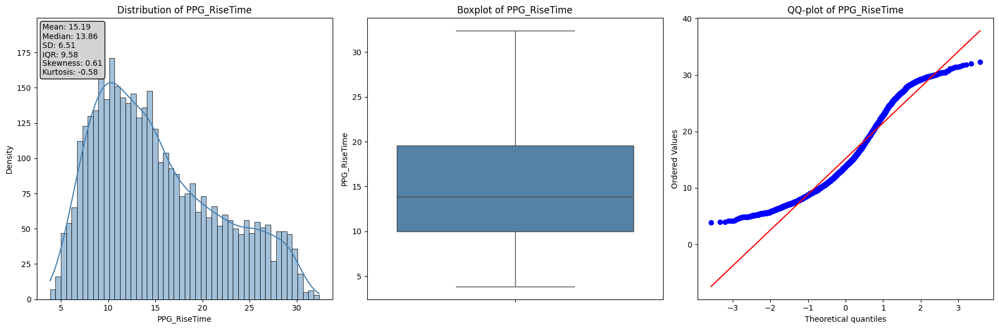

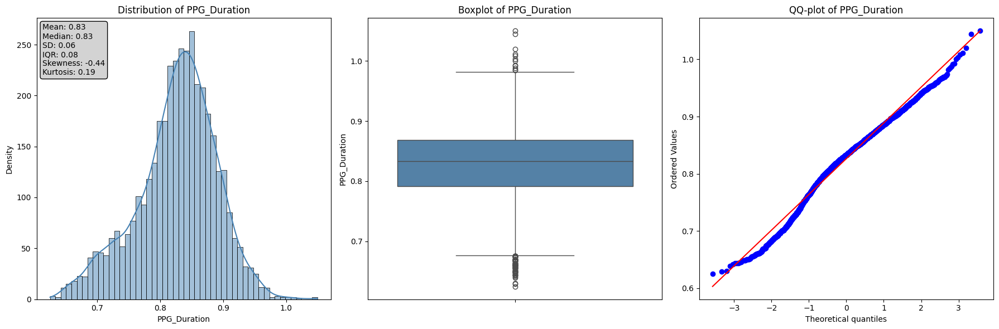

In [ ]:
plot_numerical_features(bvp_features)

In [ ]:
def shapiro_wilk_test(df, exclude_col='label', alpha=0.05):

    results = []
    numeric_cols = df.select_dtypes(include='number').columns.drop(exclude_col)

    for col in numeric_cols:
        stat, p_value = shapiro(df[col].dropna())
        is_normal = p_value > alpha
        results.append({
            "Feature": col,
            "W-Statistic": stat,
            "p-value": p_value,
            "Normally Distributed": "Yes" if is_normal else "No"
        })

    return pd.DataFrame(results).sort_values(by="p-value", ascending=True)

In [ ]:
shapiro_wilk_test(bvp_features)

,Feature,W-Statistic,p-value,Normally Distributed
13,HRV_LFHF,0.052294,2.552769e-88,No
0,HRV_MeanNN,0.458083,3.561458e-76,No
3,HRV_IQRNN,0.562914,9.517515e-72,No
15,HRV_LnHF,0.643638,1.141308e-67,No
28,HRV_MFDFA_alpha1_Fluctuation,0.646133,1.568856e-67,No
4,HRV_SDRMSSD,0.656379,5.913272e-67,No
18,HRV_GI,0.701792,3.283564e-64,No
7,HRV_MinNN,0.744605,2.815557e-61,No
6,HRV_pNN50,0.796703,4.357956e-57,No
14,HRV_LFn,0.864739,5.524447e-50,No


In [ ]:
def test_label_subject_interaction(df, label_col='label', subject_col='subject', alpha=0.05):
    numerical_cols = df.drop(columns=[label_col, subject_col]).select_dtypes(include='number').columns
    summary = []

    for feature in numerical_cols:
        formula = f'{feature} ~ C({label_col}) + C({subject_col}) + C({label_col}):C({subject_col})'
        try:
            model = ols(formula, data=df).fit()
            anova_table = sm.stats.anova_lm(model, typ=2)

            p_label = anova_table.loc[f'C({label_col})', 'PR(>F)']
            p_subject = anova_table.loc[f'C({subject_col})', 'PR(>F)']
            p_interaction = anova_table.loc[f'C({label_col}):C({subject_col})', 'PR(>F)']

            summary.append({
                'feature': feature,
                'p_label': p_label,
                'p_subject': p_subject,
                'p_interaction': p_interaction,
                'significant_interaction': p_interaction < alpha
            })

        except Exception as e:
            summary.append({
                'feature': feature,
                'p_label': None,
                'p_subject': None,
                'p_interaction': None,
                'significant_interaction': None,
                'Error': str(e)
            })

    results_df = pd.DataFrame(summary)
    return results_df

In [ ]:
test_label_subject_interaction(bvp_features)

,feature,p_label,p_subject,p_interaction,significant_interaction
0,HRV_MeanNN,2.979168e-02,2.640202e-122,6.261181e-10,True
1,HRV_MedianNN,1.343119e-01,0.000000e+00,1.833862e-51,True
2,HRV_MadNN,1.505182e-99,4.913265e-314,8.321702e-60,True
3,HRV_IQRNN,2.610622e-34,2.010617e-115,7.440072e-27,True
4,HRV_SDRMSSD,4.329476e-15,2.489621e-45,6.562810e-34,True
5,HRV_Prc20NN,3.444774e-96,6.322059e-239,1.805602e-67,True
6,HRV_pNN50,8.344759e-147,0.000000e+00,1.317808e-104,True
7,HRV_MinNN,3.661087e-60,5.924710e-96,3.470738e-33,True
8,HRV_HTI,1.082209e-81,5.487636e-188,7.985553e-35,True
9,HRV_TINN,2.537383e-01,2.253868e-101,1.007481e-12,True


In [ ]:
def plot_box_features(df, target="label", plots_per_row=3):

    continuous_features = df.select_dtypes(include='number').drop(columns=[target]).columns.tolist()
    num_features = len(continuous_features)
    num_rows = math.ceil(num_features / plots_per_row)

    fig, axes = plt.subplots(num_rows, plots_per_row, figsize=(plots_per_row * 6, num_rows * 5))
    axes = axes.flatten()

    for i, feature in enumerate(continuous_features):
        sns.boxplot(
            data=df,
            x=target,
            y=feature,
            hue=target,
            ax=axes[i],
            legend=False,
            palette=["lightcoral", "lightblue"]
        )
        axes[i].set_title(f"Boxplot of {feature} by {target}")
        axes[i].set_xlabel(target)
        axes[i].set_ylabel(feature)

    for j in range(i + 1, len(axes)):
        axes[j].axis("off")

    plt.tight_layout()
    plt.show()

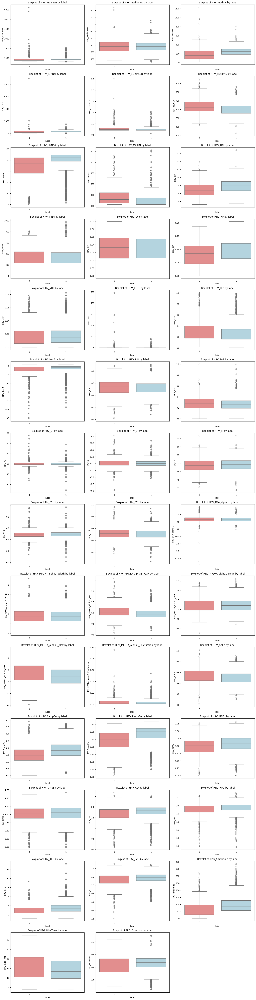

In [ ]:
plot_box_features(bvp_features)

In [ ]:
def mann_whitney_subjectwise(df, label_col='label', subject_col='subject', alpha=0.05, max_non_significant_subjects=10):
    subject_ids = df[subject_col].unique()
    features = [col for col in df.columns if col not in [label_col, subject_col] and pd.api.types.is_numeric_dtype(df[col])]

    non_significant_counts = {feature: 0 for feature in features}
    all_results = []

    for subject in subject_ids:
        df_s = df[df[subject_col] == subject]

        for feature in features:
            group1 = df_s[df_s[label_col] == 0][feature]
            group2 = df_s[df_s[label_col] == 1][feature]

            try:
                stat, p = mannwhitneyu(group1, group2, alternative='two-sided')
                if p > alpha:
                    non_significant_counts[feature] += 1
                all_results.append({
                    'subject': subject,
                    'feature': feature,
                    'U_stat': stat,
                    'p_value': p,
                    'significant': p < alpha
                })
            except:

                non_significant_counts[feature] += 1
                all_results.append({
                    'subject': subject,
                    'feature': feature,
                    'U_stat': None,
                    'p_value': None,
                    'significant': False
                })

    results_df = pd.DataFrame(all_results)

    to_drop = [feature for feature, count in non_significant_counts.items() if count > max_non_significant_subjects]

    return results_df, to_drop

In [ ]:
mw_results, features_to_drop = mann_whitney_subjectwise(bvp_features)

print("Feature da rimuovere:", features_to_drop)

Feature da rimuovere: ['HRV_MeanNN', 'HRV_SDRMSSD', 'HRV_MinNN', 'HRV_TINN', 'HRV_LF', 'HRV_HF', 'HRV_VHF', 'HRV_LFHF', 'HRV_LFn', 'HRV_LnHF', 'HRV_PIP', 'HRV_PAS', 'HRV_GI', 'HRV_SI', 'HRV_PI', 'HRV_C1d', 'HRV_C2d', 'HRV_DFA_alpha1', 'HRV_MFDFA_alpha1_Width', 'HRV_MFDFA_alpha1_Mean', 'HRV_MFDFA_alpha1_Max', 'HRV_MFDFA_alpha1_Fluctuation', 'HRV_ApEn', 'HRV_MSEn', 'HRV_CMSEn', 'HRV_HFD', 'HRV_KFD', 'HRV_LZC', 'PPG_RiseTime']


In [ ]:
bvp_features = bvp_features.drop(columns=features_to_drop, axis = 1)

In [ ]:
print("Final Shape of BVP Features:", bvp_features.shape)
bvp_features.head()

Final Shape of BVP Features: (3939, 15)


,HRV_MedianNN,HRV_MadNN,HRV_IQRNN,HRV_Prc20NN,HRV_pNN50,HRV_HTI,HRV_MFDFA_alpha1_Peak,HRV_SampEn,HRV_FuzzyEn,HRV_CD,PPG_Amplitude,PPG_Duration,label,subject,protocol_phase
0,812.5000,254.821875,328.12500,593.750,78.571429,11.666667,1.413250,0.762140,1.292808,1.298336,83.759489,0.884943,0,subject_01,rest_1
1,812.5000,231.656250,312.50000,593.750,75.342466,12.166667,1.448590,0.716678,1.345371,1.367988,58.810724,0.835387,0,subject_01,rest_1
2,765.6250,277.987500,371.09375,540.625,81.081081,18.500000,0.999903,1.326871,1.525195,1.640540,53.853158,0.824384,0,subject_01,rest_1
3,804.6875,243.239062,289.06250,621.875,80.000000,17.500000,0.802337,1.365241,1.664060,1.742129,46.167827,0.805651,0,subject_01,rest_1
4,781.2500,231.656250,312.50000,615.625,80.821918,14.600000,0.543934,2.058388,1.769900,1.827572,42.130300,0.820530,0,subject_01,rest_1


In [ ]:
eda_raw = df["eda"].values

fs = 64

eda_signals, eda_info = nk.eda_process(eda_raw, sampling_rate=fs)

eda_clean = eda_signals["EDA_Clean"]

df['eda_clean'] = eda_clean

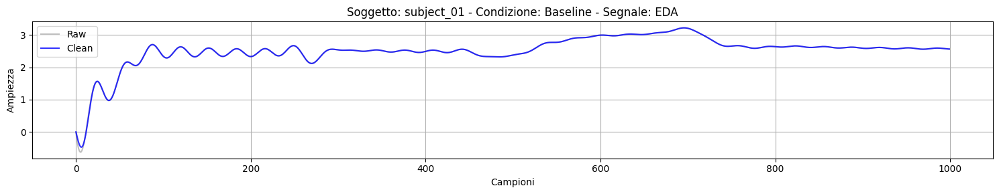

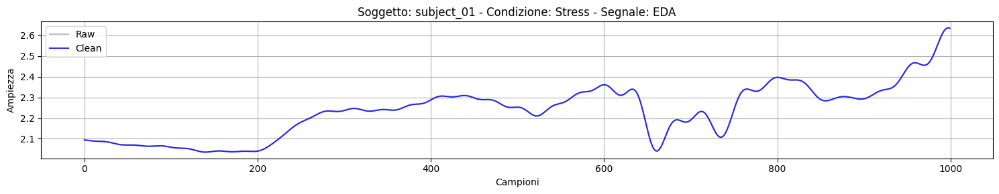

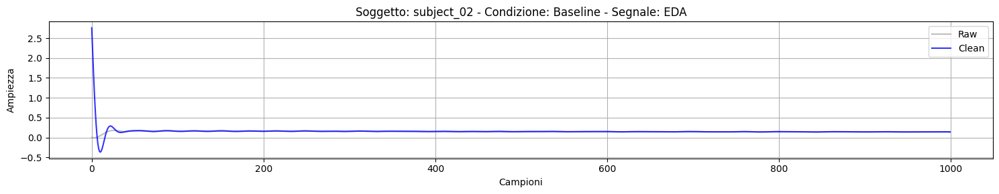

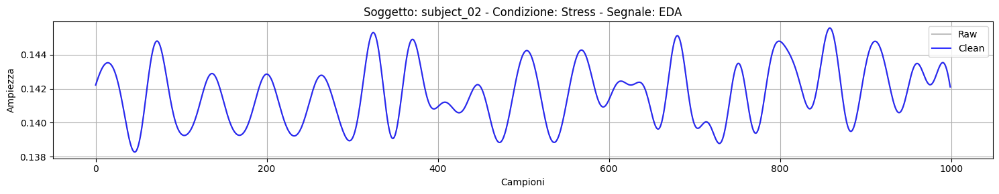

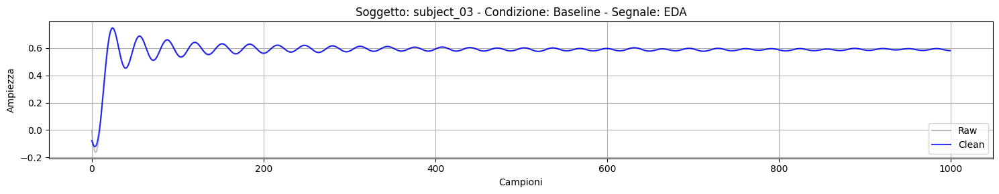

...

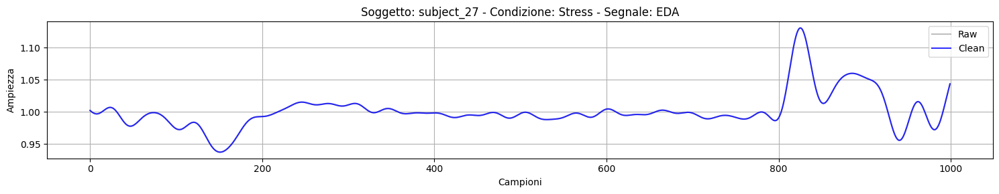

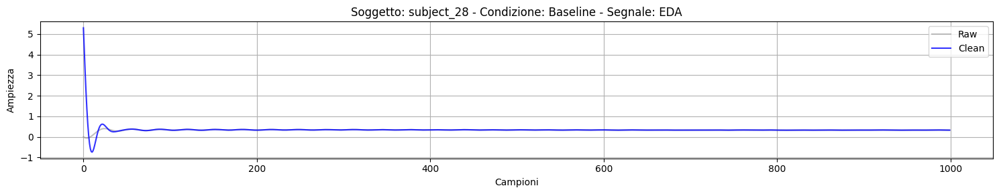

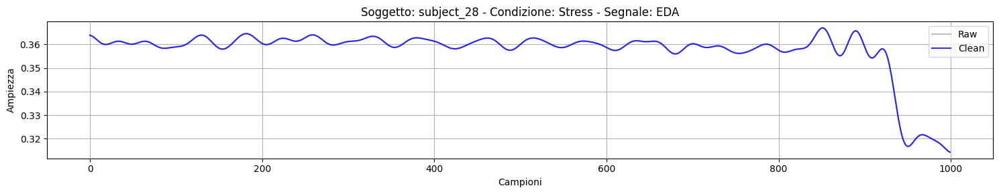

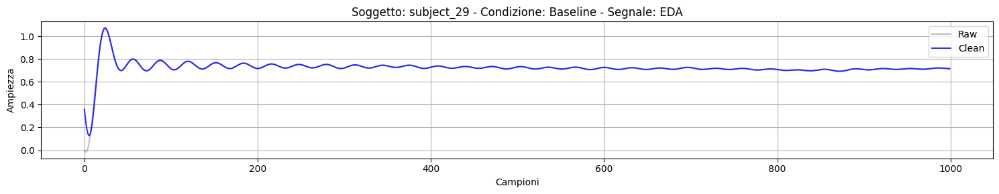

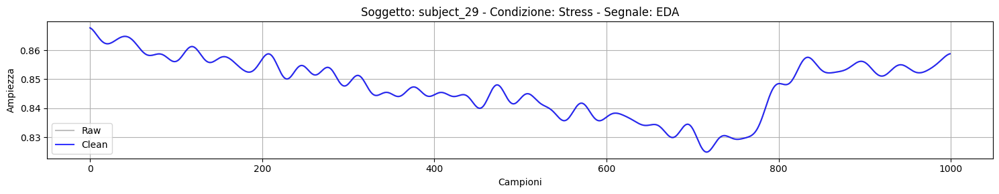

In [ ]:
plot_raw_vs_clean_from_single_df(df, 'eda', 'eda_clean', n_points = 1000)

In [ ]:
# Parametri
fs = 64  # Frequenza di campionamento
window_sec = 60
overlap = 0.75
window_size = int(fs * window_sec)
step_size = int(window_size * (1 - overlap))

# Lista per raccogliere le feature
eda_features_list = []

# Scorri per finestra
for start in range(0, len(df) - window_size, step_size):
    window_signal = df["eda_clean"].iloc[start:start + window_size].values
    labels = df["label"].iloc[start:start + window_size].values
    phases = df["protocol_phase"].iloc[start:start + window_size].values
    subject = df["subject"].iloc[start]

    # Conta le etichette nella finestra
    counts = np.bincount(labels.astype(int), minlength=2)
    total = counts.sum()
    dominant_label = np.argmax(counts)
    dominant_ratio = counts[dominant_label] / total

    # Scarta finestre ambigue (<70% di predominanza)
    if dominant_ratio < 0.7:
        continue

    label = dominant_label
    protocol_phase = pd.Series(phases).mode()[0]

    try:
        # Estrai caratteristiche EDA da finestra
        eda_signals, eda_info = nk.eda_peaks(window_signal, sampling_rate=fs)
        features = nk.eda_intervalrelated(eda_signals, sampling_rate=fs)

        # Aggiungi metadati
        features["label"] = label
        features["subject"] = subject
        features["protocol_phase"] = protocol_phase

        eda_features_list.append(features)

    except Exception as e:
        print(f"Errore nella finestra {start}-{start + window_size}: {e}")

# Combina tutte le feature in un unico DataFrame
if eda_features_list:
    eda_features = pd.concat(eda_features_list, ignore_index=True)
else:
    print("Nessuna finestra valida.")
    eda_features = pd.DataFrame()

In [ ]:
print("Shape of EDA features:", eda_features.shape)
eda_features.head()

Shape of EDA features: (3939, 8)


,SCR_Peaks_N,SCR_Peaks_Amplitude_Mean,EDA_Sympathetic,EDA_SympatheticN,EDA_Autocorrelation,label,subject,protocol_phase
0,12.0,0.398431,NaN,NaN,NaN,0,subject_01,rest_1
1,12.0,0.066800,NaN,NaN,NaN,0,subject_01,rest_1
2,13.0,0.078231,NaN,NaN,NaN,0,subject_01,rest_1
3,14.0,0.093472,NaN,NaN,NaN,0,subject_01,rest_1
4,12.0,0.101035,NaN,NaN,NaN,0,subject_01,rest_1


In [ ]:
eda_features.isna().sum()

,0
SCR_Peaks_N,0
SCR_Peaks_Amplitude_Mean,0
EDA_Sympathetic,3939
EDA_SympatheticN,3939
EDA_Autocorrelation,3939
label,0
subject,0
protocol_phase,0


In [ ]:
for columns in eda_features.columns:
  print(columns)

SCR_Peaks_N
SCR_Peaks_Amplitude_Mean
EDA_Sympathetic
EDA_SympatheticN
EDA_Autocorrelation
label
subject
protocol_phase


In [ ]:
eda_features = drop_columns_with_nans(eda_features)
eda_features = eda_features.fillna(eda_features.median(numeric_only=True))

In [ ]:
sum(eda_features.isna().sum())

0

In [ ]:
eda_features.head()

,SCR_Peaks_N,SCR_Peaks_Amplitude_Mean,label,subject,protocol_phase
0,12.0,0.398431,0,subject_01,rest_1
1,12.0,0.066800,0,subject_01,rest_1
2,13.0,0.078231,0,subject_01,rest_1
3,14.0,0.093472,0,subject_01,rest_1
4,12.0,0.101035,0,subject_01,rest_1


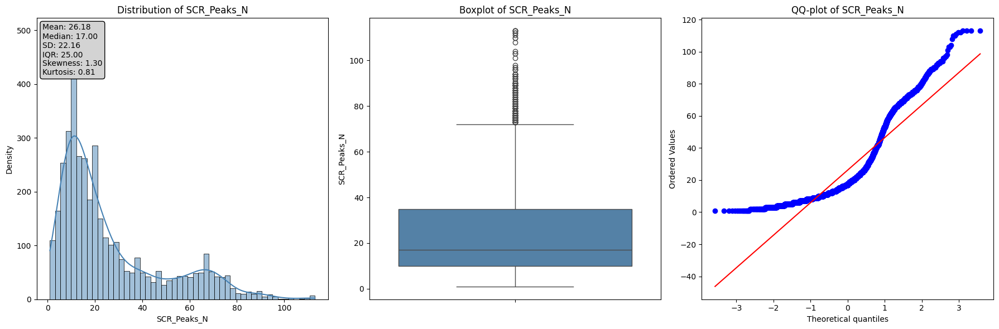

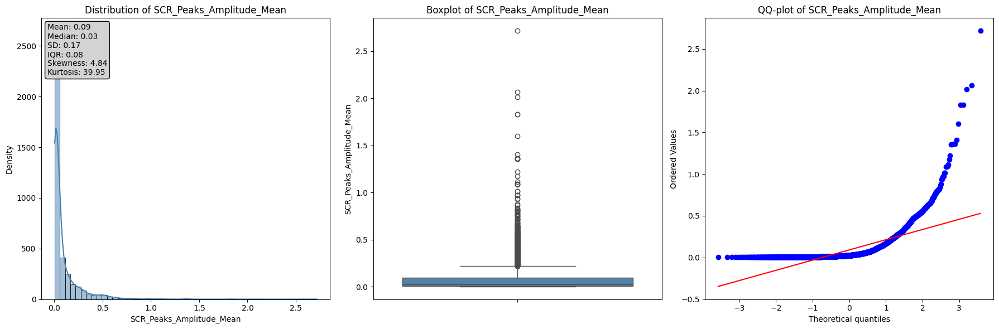

In [ ]:
plot_numerical_features(eda_features)

In [ ]:
shapiro_wilk_test(eda_features)

,Feature,W-Statistic,p-value,Normally Distributed
1,SCR_Peaks_Amplitude_Mean,0.527676,2.497930e-73,No
0,SCR_Peaks_N,0.835281,2.335307e-53,No


In [ ]:
test_label_subject_interaction(eda_features)

,feature,p_label,p_subject,p_interaction,significant_interaction
0,SCR_Peaks_N,1.022410e-17,4.248965e-322,1.235005e-18,True
1,SCR_Peaks_Amplitude_Mean,2.782140e-01,0.000000e+00,3.080921e-02,True


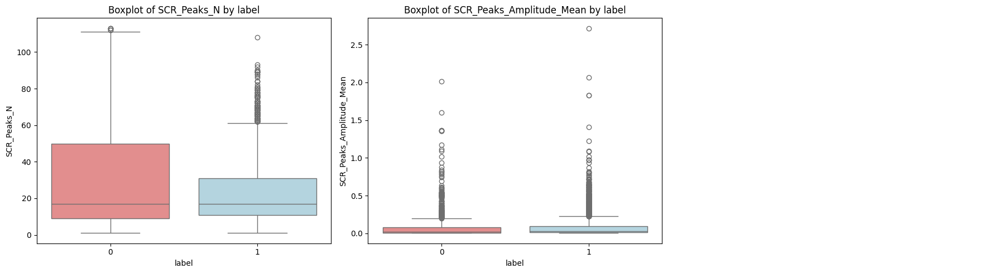

In [ ]:
plot_box_features(eda_features)

In [ ]:
mw_results, features_to_drop = mann_whitney_subjectwise(eda_features)

print("Feature da rimuovere:", features_to_drop)

Feature da rimuovere: ['SCR_Peaks_N', 'SCR_Peaks_Amplitude_Mean']


In [ ]:
print("Final Shape of EDA Features:", eda_features.shape)
eda_features.head()

Final Shape of EDA Features: (3939, 5)


,SCR_Peaks_N,SCR_Peaks_Amplitude_Mean,label,subject,protocol_phase
0,12.0,0.398431,0,subject_01,rest_1
1,12.0,0.066800,0,subject_01,rest_1
2,13.0,0.078231,0,subject_01,rest_1
3,14.0,0.093472,0,subject_01,rest_1
4,12.0,0.101035,0,subject_01,rest_1


In [ ]:
def butter_highpass(cutoff, fs, order=5):
    nyq = 0.5 * fs
    normal_cutoff = cutoff / nyq
    b, a = butter(order, normal_cutoff, btype='high', analog=False)
    return b, a

def butter_lowpass(cutoff, fs, order=5):
    nyq = 0.5 * fs
    normal_cutoff = cutoff / nyq
    b, a = butter(order, normal_cutoff, btype='low', analog=False)
    return b, a

In [ ]:
def acc_denoise(acc_signal, fs):

    b_high, a_high = butter_highpass(0.5, fs)
    acc_signal = filtfilt(b_high, a_high, acc_signal)

    b_low, a_low = butter_lowpass(20.0, fs)
    acc_signal = filtfilt(b_low, a_low, acc_signal)

    return acc_signal

In [ ]:
fs = 64
df['acc_mag_clean'] = acc_denoise(df['acc_mag'].values, fs)

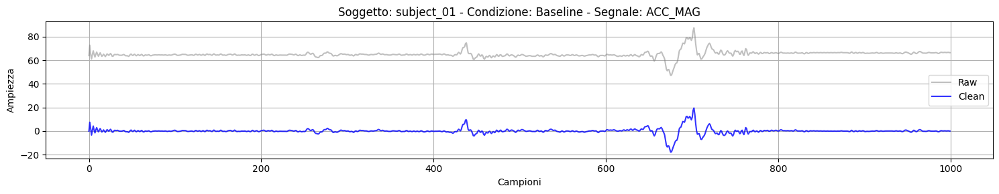

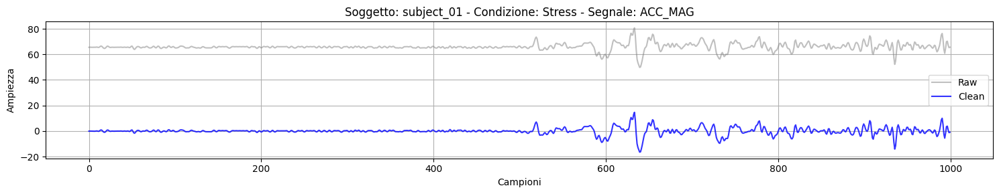

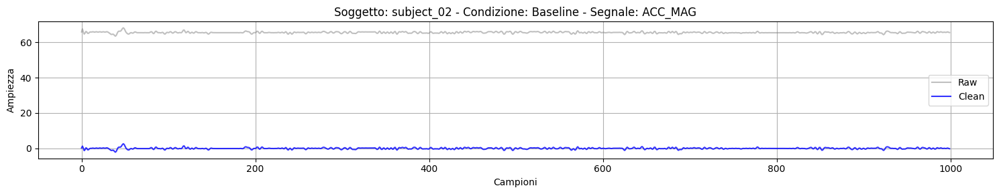

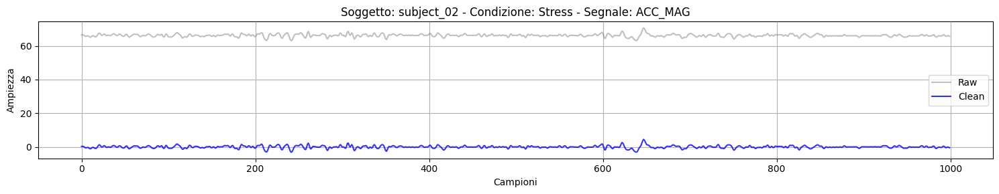

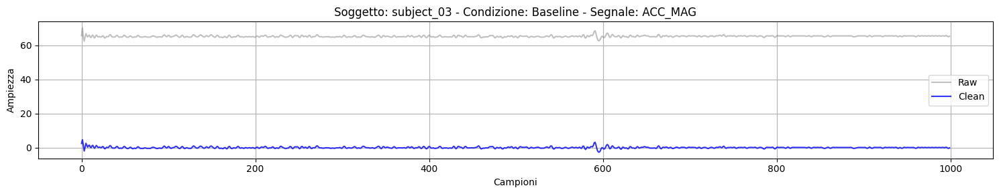

...

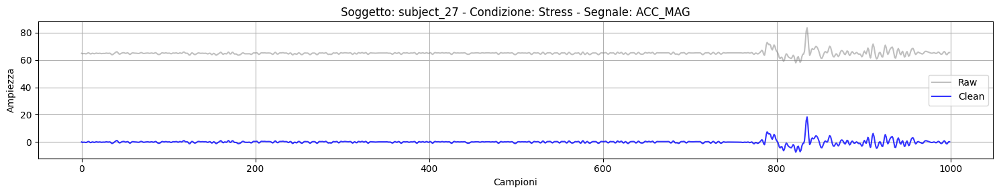

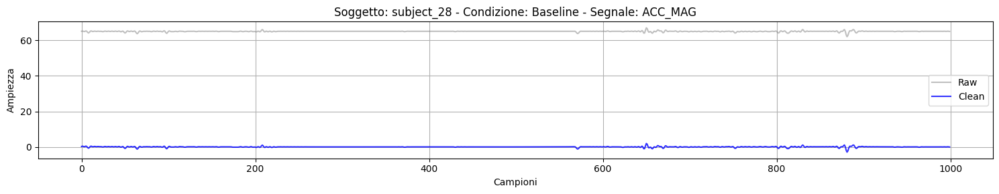

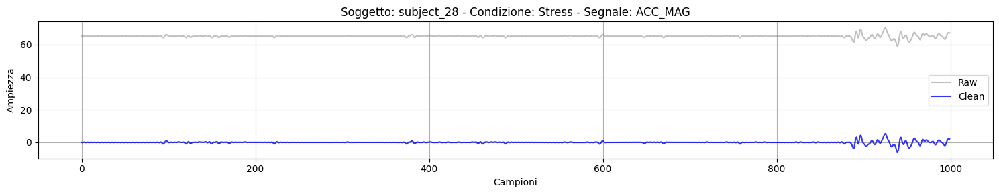

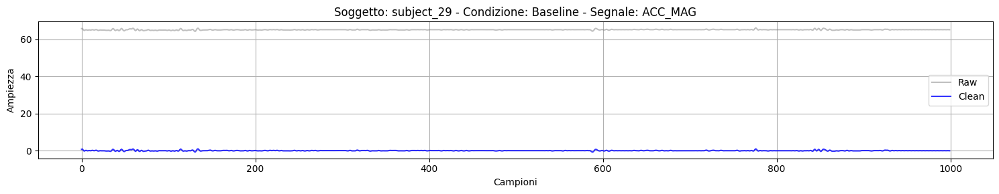

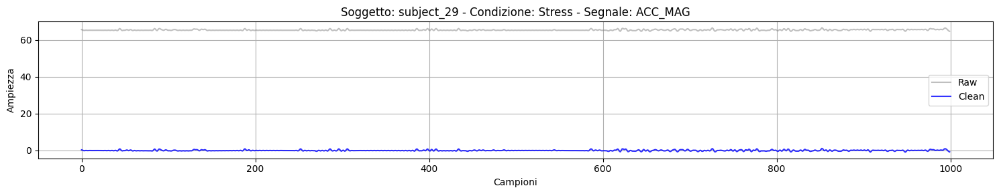

In [ ]:
plot_raw_vs_clean_from_single_df(df, 'acc_mag', 'acc_mag_clean', n_points = 1000)

In [ ]:
# Parametri
fs = 64  # frequenza di campionamento
window_sec = 60
overlap = 0.75
window_size = int(fs * window_sec)
step_size = int(window_size * (1 - overlap))

# Lista per salvare le feature
acc_features_list = []

# Estrai feature per ciascun soggetto
for subject_id in df["subject"].unique():
    print(f"Elaborazione soggetto {subject_id}")
    df_s = df[df["subject"] == subject_id].reset_index(drop=True)

    for start in range(0, len(df_s) - window_size + 1, step_size):
        end = start + window_size

        window = df_s["acc_mag"].iloc[start:end].values
        labels = df_s["label"].iloc[start:end].values
        phases = df_s["protocol_phase"].iloc[start:end].values

        if len(window) == 0:
            continue

        # Conta le etichette nella finestra
        counts = np.bincount(labels.astype(int), minlength=2)
        total = counts.sum()
        dominant_label = np.argmax(counts)
        dominant_ratio = counts[dominant_label] / total

        # Scarta finestra se nessuna classe è ≥ 70%
        if dominant_ratio < 0.7:
            continue

        label = dominant_label
        protocol_phase = pd.Series(phases).mode()[0]

        try:
            features = {
                "AccMag_Mean": np.mean(window),
                "AccMag_Std": np.std(window),
                "AccMag_Max": np.max(window),
                "AccMag_Min": np.min(window),
                "AccMag_Range": np.max(window) - np.min(window),
                "AccMag_Median": np.median(window),
                "AccMag_IQR": np.percentile(window, 75) - np.percentile(window, 25),
                "AccMag_Skew": scipy.stats.skew(window),
                "AccMag_Kurtosis": scipy.stats.kurtosis(window),
                "label": label,
                "subject": subject_id,
                "protocol_phase": protocol_phase
            }
            acc_features_list.append(features)

        except Exception as e:
            print(f"Errore finestra {start}-{end}: {e}")
            continue

# Combina le feature in un DataFrame
acc_features = pd.DataFrame(acc_features_list)

Elaborazione soggetto subject_01
Elaborazione soggetto subject_02
Elaborazione soggetto subject_03
Elaborazione soggetto subject_04
Elaborazione soggetto subject_05
Elaborazione soggetto subject_06
Elaborazione soggetto subject_07
Elaborazione soggetto subject_08
Elaborazione soggetto subject_09
Elaborazione soggetto subject_10
Elaborazione soggetto subject_11
Elaborazione soggetto subject_12
Elaborazione soggetto subject_13
Elaborazione soggetto subject_14
Elaborazione soggetto subject_15
Elaborazione soggetto subject_16
Elaborazione soggetto subject_17
Elaborazione soggetto subject_18
Elaborazione soggetto subject_19
Elaborazione soggetto subject_20
Elaborazione soggetto subject_21
Elaborazione soggetto subject_22
Elaborazione soggetto subject_23
Elaborazione soggetto subject_24
Elaborazione soggetto subject_25
Elaborazione soggetto subject_26
Elaborazione soggetto subject_27
Elaborazione soggetto subject_28
Elaborazione soggetto subject_29


In [ ]:
print("Shape of ACC Features", acc_features.shape)
acc_features.head()

Shape of ACC Features (3906, 12)


,AccMag_Mean,AccMag_Std,AccMag_Max,AccMag_Min,AccMag_Range,AccMag_Median,AccMag_IQR,AccMag_Skew,AccMag_Kurtosis,label,subject,protocol_phase
0,65.858626,1.889886,87.527139,47.156991,40.370148,65.954530,1.092830,0.284325,28.430252,0,subject_01,rest_1
1,65.990419,1.886298,81.024688,49.010203,32.014485,66.000000,0.886322,-0.469585,21.098319,0,subject_01,rest_1
2,65.940405,1.911598,81.024688,49.010203,32.014485,65.946948,0.872183,-0.293148,20.118064,0,subject_01,rest_1
3,65.929956,2.112601,103.340108,38.115739,65.224370,65.946948,0.842420,1.708153,71.986934,0,subject_01,rest_1
4,65.921856,2.096322,103.340108,38.115739,65.224370,65.924199,0.829840,1.740178,74.305574,0,subject_01,rest_1


In [ ]:
for columns in acc_features.columns:
  print(columns)

AccMag_Mean
AccMag_Std
AccMag_Max
AccMag_Min
AccMag_Range
AccMag_Median
AccMag_IQR
AccMag_Skew
AccMag_Kurtosis
label
subject
protocol_phase


In [ ]:
acc_features.isna().sum()

,0
AccMag_Mean,0
AccMag_Std,0
AccMag_Max,0
AccMag_Min,0
AccMag_Range,0
AccMag_Median,0
AccMag_IQR,0
AccMag_Skew,0
AccMag_Kurtosis,0
label,0


In [ ]:
acc_features, removed_cols = drop_highly_correlated_features(acc_features, exclude_cols=['label', 'subject', 'protocol_phase'])

print("Colonne rimosse:", removed_cols)
print("Dimensione dataset:", acc_features.shape)

Colonne rimosse: ['AccMag_Min', 'AccMag_Range', 'AccMag_Median', 'AccMag_Kurtosis']
Dimensione dataset: (3906, 8)


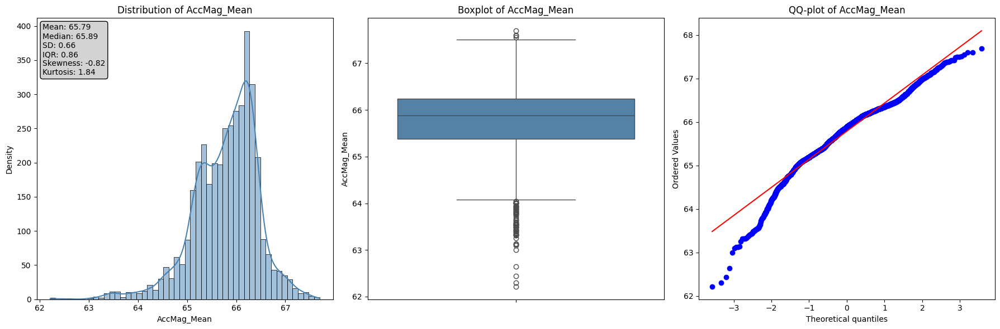

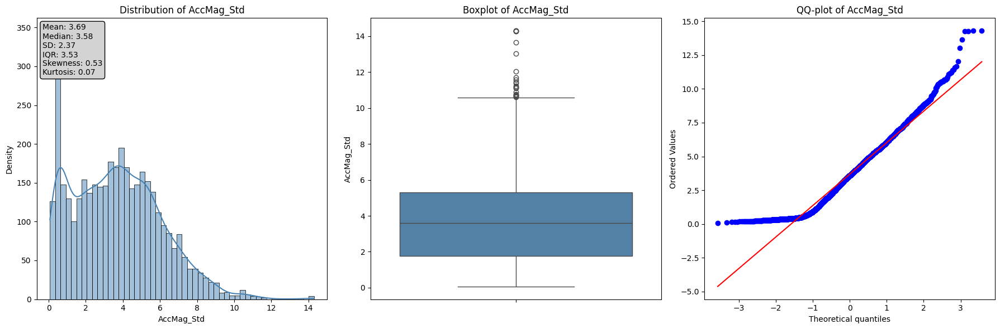

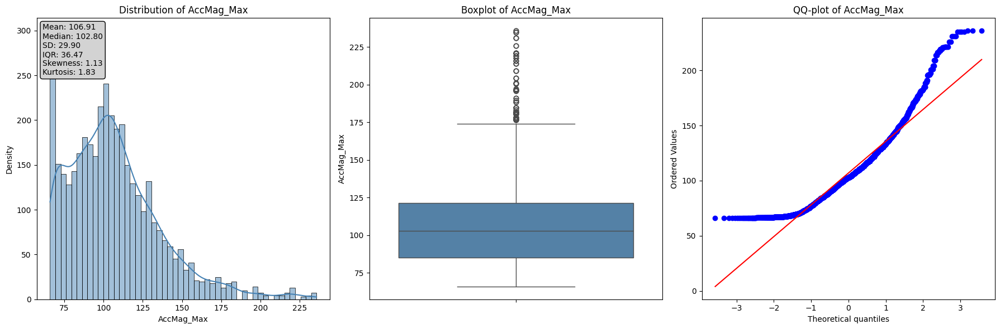

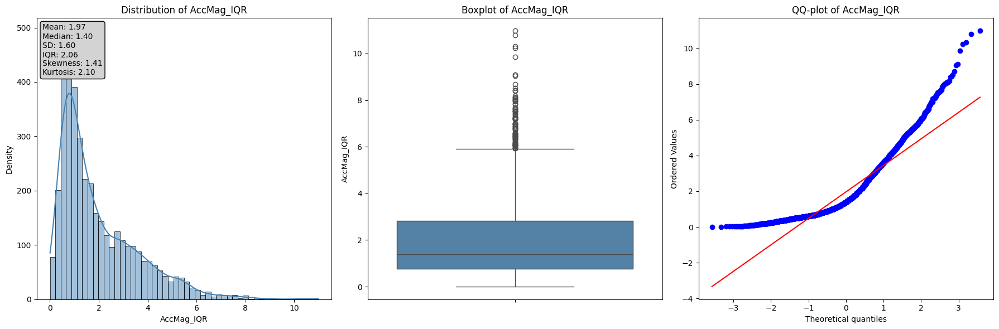

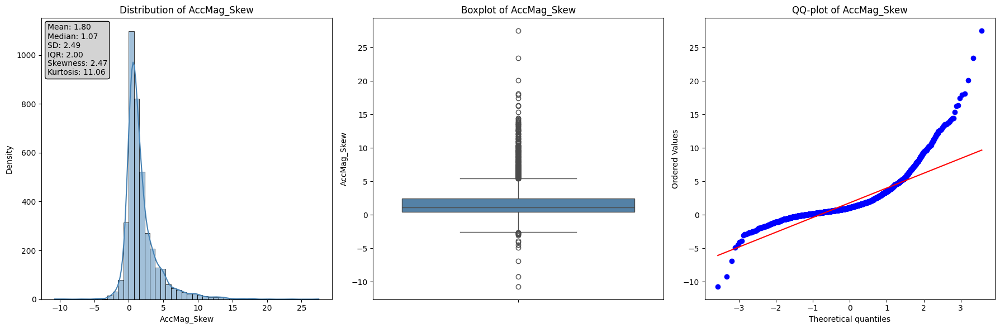

In [ ]:
plot_numerical_features(acc_features)

In [ ]:
shapiro_wilk_test(acc_features)

,Feature,W-Statistic,p-value,Normally Distributed
4,AccMag_Skew,0.781838,3.372534e-58,No
3,AccMag_IQR,0.861376,3.032870e-50,No
2,AccMag_Max,0.926123,3.330047e-40,No
0,AccMag_Mean,0.961840,6.525616e-31,No
1,AccMag_Std,0.963134,1.840500e-30,No


In [ ]:
test_label_subject_interaction(acc_features)

,feature,p_label,p_subject,p_interaction,significant_interaction
0,AccMag_Mean,2.336172e-68,2.278280e-203,1.218679e-52,True
1,AccMag_Std,3.891929e-72,4.895669e-194,1.689311e-71,True
2,AccMag_Max,1.078159e-02,7.332880e-175,5.416864e-49,True
3,AccMag_IQR,2.441136e-168,2.115579e-179,2.465746e-67,True
4,AccMag_Skew,2.394103e-23,4.883176e-49,3.496709e-12,True


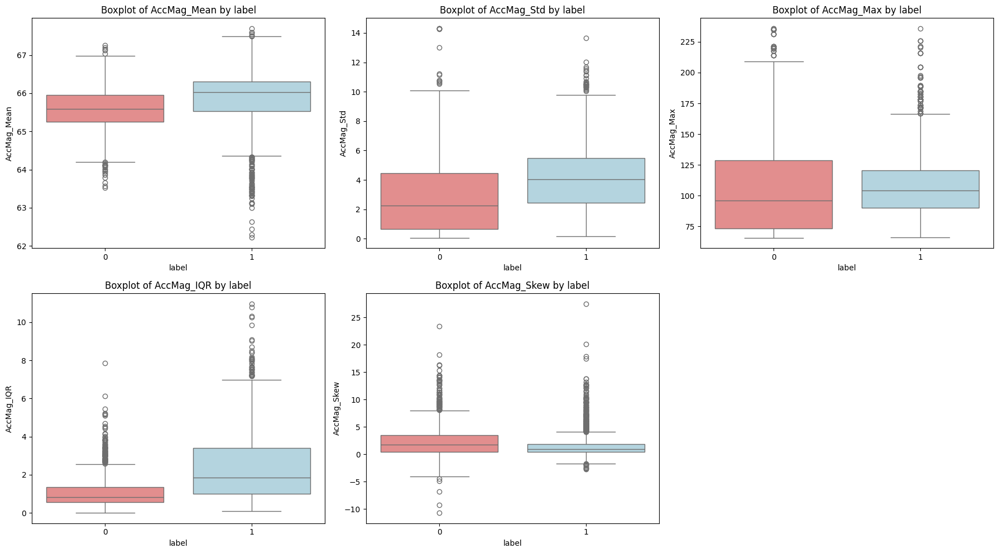

In [ ]:
plot_box_features(acc_features)

In [ ]:
mw_results, features_to_drop = mann_whitney_subjectwise(eda_features)

print("Feature da rimuovere:", features_to_drop)

Feature da rimuovere: ['SCR_Peaks_N', 'SCR_Peaks_Amplitude_Mean']


In [ ]:
print("Final Shape of ACC Features:", acc_features.shape)
acc_features.head()

Final Shape of ACC Features: (3906, 8)


,AccMag_Mean,AccMag_Std,AccMag_Max,AccMag_IQR,AccMag_Skew,label,subject,protocol_phase
0,65.858626,1.889886,87.527139,1.092830,0.284325,0,subject_01,rest_1
1,65.990419,1.886298,81.024688,0.886322,-0.469585,0,subject_01,rest_1
2,65.940405,1.911598,81.024688,0.872183,-0.293148,0,subject_01,rest_1
3,65.929956,2.112601,103.340108,0.842420,1.708153,0,subject_01,rest_1
4,65.921856,2.096322,103.340108,0.829840,1.740178,0,subject_01,rest_1


In [ ]:
def temp_denoise(temp_signal, fs):
  b_low, a_low = butter_lowpass(0.5, fs)
  temp_signal = filtfilt(b_low, a_low, temp_signal)
  return temp_signal

In [ ]:
fs = 64
df['temp_clean'] = temp_denoise(df['temp'].values, fs)

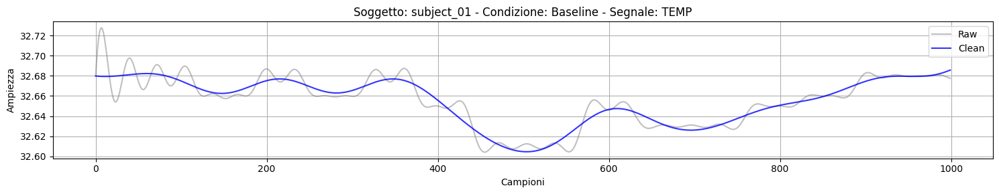

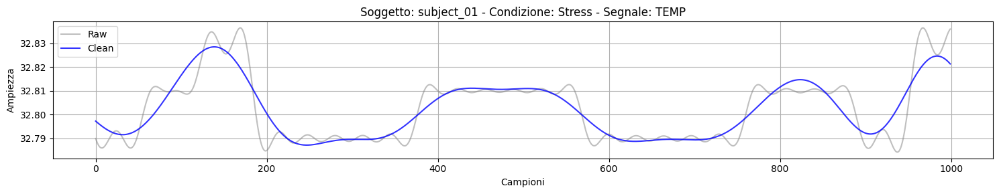

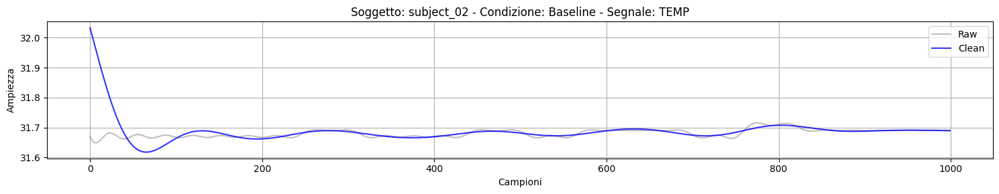

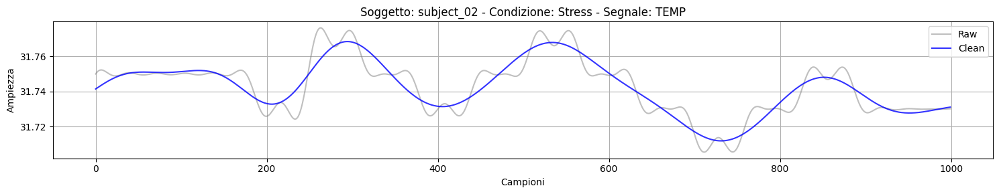

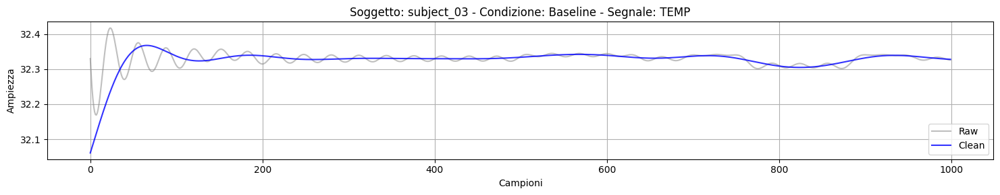

...

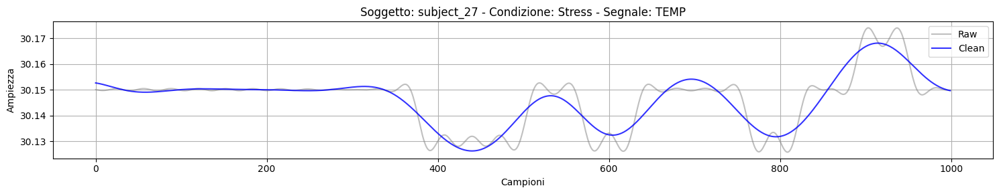

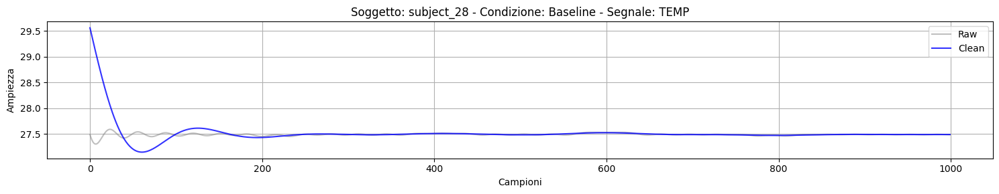

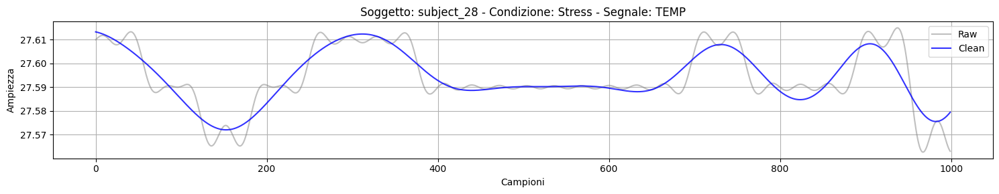

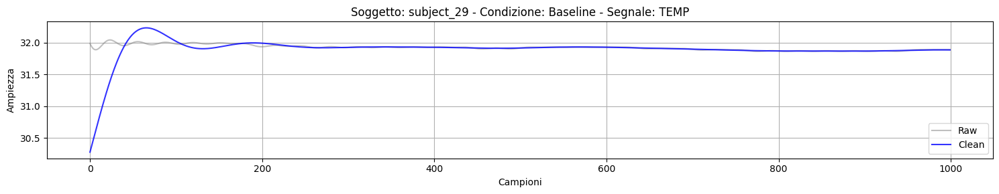

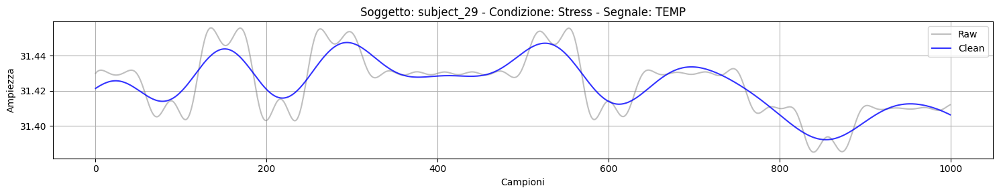

In [ ]:
plot_raw_vs_clean_from_single_df(df, 'temp', 'temp_clean', n_points = 1000)

In [ ]:
# Parametri
fs = 64  # frequenza di campionamento
window_sec = 60
overlap = 0.75
window_size = int(window_sec * fs)
step_size = int(window_size * (1 - overlap))

# Lista per raccogliere le feature
features_list = []

# Estrazione feature per ogni finestra
for start in range(0, len(df) - window_size + 1, step_size):
    end = start + window_size
    window_signal = df["temp_clean"].iloc[start:end].values
    window_labels = df["label"].iloc[start:end].values
    window_phases = df["protocol_phase"].iloc[start:end].values
    window_subject = df["subject"].iloc[start]

    # Calcola label dominante e la sua frequenza
    counts = np.bincount(window_labels.astype(int), minlength=2)
    total = counts.sum()
    dominant_label = np.argmax(counts)
    dominant_ratio = counts[dominant_label] / total

    # Scarta finestre ambigue (<70% di predominanza)
    if dominant_ratio < 0.7:
        continue

    label = dominant_label
    protocol_phase = pd.Series(window_phases).mode()[0]

    try:
        mean_val = np.mean(window_signal)
        std_val = np.std(window_signal)
        min_val = np.min(window_signal)
        max_val = np.max(window_signal)
        slope = np.polyfit(np.arange(len(window_signal)), window_signal, 1)[0]

        features = {
            "Temp_Mean": mean_val,
            "Temp_Std": std_val,
            "Temp_Min": min_val,
            "Temp_Max": max_val,
            "Temp_Slope": slope,
            "label": label,
            "subject": window_subject,
            "protocol_phase": protocol_phase
        }

        features_list.append(features)

    except Exception as e:
        print(f"Errore nella finestra {start}-{end}: {e}")
        continue

# Combina tutte le feature in un DataFrame
if features_list:
    temp_features = pd.DataFrame(features_list)
else:
    print("Nessuna finestra valida.")
    temp_features = pd.DataFrame()

In [ ]:
print("Shape of TEMP Features", temp_features.shape)
temp_features.head()

Shape of TEMP Features (3939, 8)


,Temp_Mean,Temp_Std,Temp_Min,Temp_Max,Temp_Slope,label,subject,protocol_phase
0,32.708117,0.040986,32.604476,32.787640,0.000033,0,subject_01,rest_1
1,32.739169,0.033575,32.674286,32.807621,0.000027,0,subject_01,rest_1
2,32.760658,0.029757,32.682905,32.807621,0.000024,0,subject_01,rest_1
3,32.781543,0.020603,32.728759,32.820733,0.000015,0,subject_01,rest_1
4,32.796625,0.019075,32.751033,32.836765,0.000014,0,subject_01,rest_1


In [ ]:
for columns in temp_features.columns:
  print(columns)

Temp_Mean
Temp_Std
Temp_Min
Temp_Max
Temp_Slope
label
subject
protocol_phase


In [ ]:
temp_features.isna().sum()

,0
Temp_Mean,0
Temp_Std,0
Temp_Min,0
Temp_Max,0
Temp_Slope,0
label,0
subject,0
protocol_phase,0


In [ ]:
temp_features, removed_cols = drop_highly_correlated_features(temp_features, exclude_cols=['label', 'subject', 'protocol_phase'])

print("Colonne rimosse:", removed_cols)
print("Dimensione dataset:", temp_features.shape)

Colonne rimosse: ['Temp_Min', 'Temp_Max']
Dimensione dataset: (3939, 6)


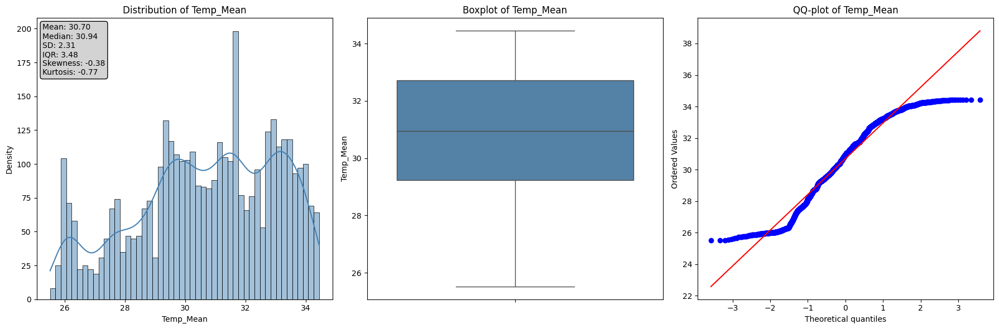

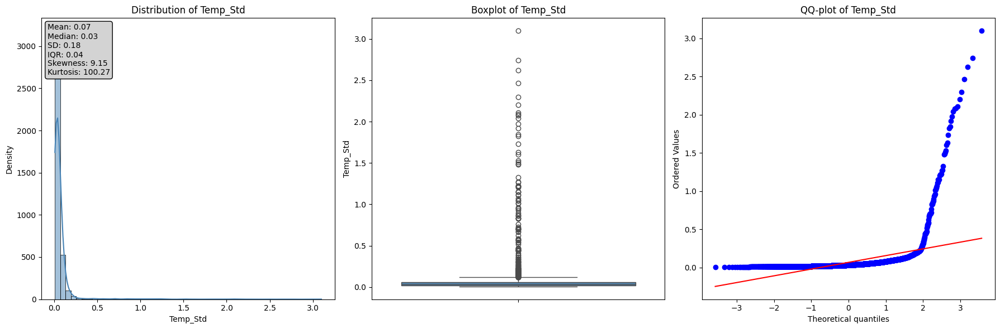

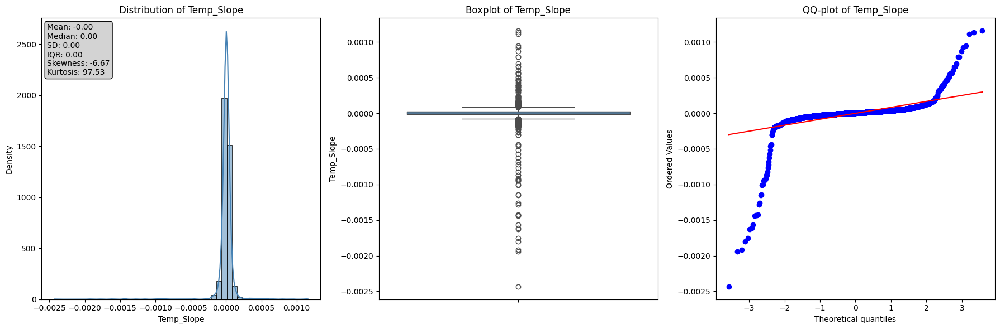

In [ ]:
plot_numerical_features(temp_features)

In [ ]:
shapiro_wilk_test(temp_features)

,Feature,W-Statistic,p-value,Normally Distributed
1,Temp_Std,0.237875,1.784346e-83,No
2,Temp_Slope,0.365686,1.673870e-79,No
0,Temp_Mean,0.960283,1.486696e-31,No


In [ ]:
test_label_subject_interaction(temp_features)

,feature,p_label,p_subject,p_interaction,significant_interaction
0,Temp_Mean,1.076125e-03,0.000000e+00,4.085562e-17,True
1,Temp_Std,8.961169e-31,1.113745e-14,2.322985e-04,True
2,Temp_Slope,9.255288e-10,1.426187e-06,1.167365e-22,True


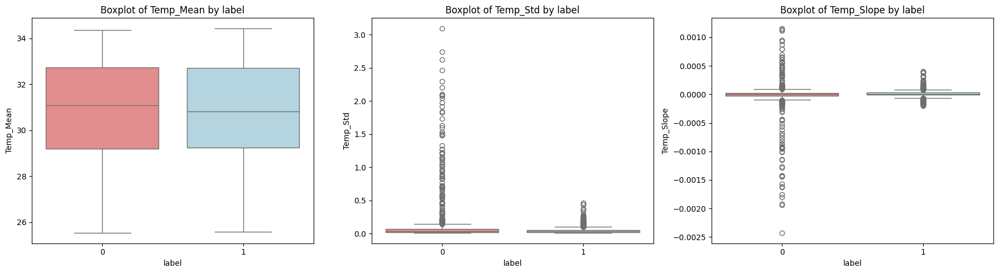

In [ ]:
plot_box_features(temp_features)

In [ ]:
mw_results, features_to_drop = mann_whitney_subjectwise(temp_features)

print("Feature da rimuovere:", features_to_drop)

Feature da rimuovere: ['Temp_Mean', 'Temp_Std', 'Temp_Slope']


In [ ]:
temp_features = temp_features.drop(columns=features_to_drop, axis = 1)

In [ ]:
print("Final Shape of TEMP Features:", temp_features.shape)
temp_features.head()

Final Shape of TEMP Features: (3939, 3)


,label,subject,protocol_phase
0,0,subject_01,rest_1
1,0,subject_01,rest_1
2,0,subject_01,rest_1
3,0,subject_01,rest_1
4,0,subject_01,rest_1


In [ ]:
print("Final Shape of BVP Features:", bvp_features.shape)
print("Final Shape of EDA Features:", eda_features.shape)
print("Final Shape of ACC Features:", acc_features.shape)
print("Final Shape of TEMP Features:", temp_features.shape)

Final Shape of BVP Features: (3939, 15)
Final Shape of EDA Features: (3939, 5)
Final Shape of ACC Features: (3906, 8)
Final Shape of TEMP Features: (3939, 3)


In [ ]:
datasets = ["bvp_features", "eda_features", "acc_features", "temp_features"]

for i in range(len(datasets)):
  print(f"{datasets[i]}")
  for columns in eval(datasets[i]).columns:
    print(columns)

bvp_features
HRV_MedianNN
HRV_MadNN
HRV_IQRNN
HRV_Prc20NN
HRV_pNN50
HRV_HTI
HRV_MFDFA_alpha1_Peak
HRV_SampEn
HRV_FuzzyEn
HRV_CD
PPG_Amplitude
PPG_Duration
label
subject
protocol_phase
eda_features
SCR_Peaks_N
SCR_Peaks_Amplitude_Mean
label
subject
protocol_phase
acc_features
AccMag_Mean
AccMag_Std
AccMag_Max
AccMag_IQR
AccMag_Skew
label
subject
protocol_phase
temp_features
label
subject
protocol_phase


In [ ]:
# Trova la lunghezza minima
min_len = min(len(bvp_features), len(eda_features), len(acc_features), len(temp_features))

# Troncamento e reindicizzazione
bvp_trimmed = bvp_features.iloc[:min_len].reset_index(drop=True)
eda_trimmed = eda_features.iloc[:min_len].reset_index(drop=True)
acc_trimmed = acc_features.iloc[:min_len].reset_index(drop=True)
temp_trimmed = temp_features.iloc[:min_len].reset_index(drop=True)

# Verifica che le colonne label e subject siano allineate
# Se presenti in ogni dataframe, tienile solo da uno (es: da bvp_trimmed)
eda_trimmed = eda_trimmed.drop(columns=['label', 'subject', 'protocol_phase'], errors='ignore')
acc_trimmed = acc_trimmed.drop(columns=['label', 'subject', 'protocol_phase'], errors='ignore')
temp_trimmed = temp_trimmed.drop(columns=['label', 'subject', 'protocol_phase'], errors='ignore')

# Concatenazione finale
all_features = pd.concat([bvp_trimmed, eda_trimmed, acc_trimmed, temp_trimmed], axis=1)

# Controllo dimensioni
print("Final shape of concatenated dataset:", all_features.shape)

Final shape of concatenated dataset: (3906, 22)


In [ ]:
all_features.head()

,HRV_MedianNN,HRV_MadNN,HRV_IQRNN,HRV_Prc20NN,HRV_pNN50,HRV_HTI,HRV_MFDFA_alpha1_Peak,HRV_SampEn,HRV_FuzzyEn,HRV_CD,...,label,subject,protocol_phase,SCR_Peaks_N,SCR_Peaks_Amplitude_Mean,AccMag_Mean,AccMag_Std,AccMag_Max,AccMag_IQR,AccMag_Skew
0,812.5000,254.821875,328.12500,593.750,78.571429,11.666667,1.413250,0.762140,1.292808,1.298336,...,0,subject_01,rest_1,12.0,0.398431,65.858626,1.889886,87.527139,1.092830,0.284325
1,812.5000,231.656250,312.50000,593.750,75.342466,12.166667,1.448590,0.716678,1.345371,1.367988,...,0,subject_01,rest_1,12.0,0.066800,65.990419,1.886298,81.024688,0.886322,-0.469585
2,765.6250,277.987500,371.09375,540.625,81.081081,18.500000,0.999903,1.326871,1.525195,1.640540,...,0,subject_01,rest_1,13.0,0.078231,65.940405,1.911598,81.024688,0.872183,-0.293148
3,804.6875,243.239062,289.06250,621.875,80.000000,17.500000,0.802337,1.365241,1.664060,1.742129,...,0,subject_01,rest_1,14.0,0.093472,65.929956,2.112601,103.340108,0.842420,1.708153
4,781.2500,231.656250,312.50000,615.625,80.821918,14.600000,0.543934,2.058388,1.769900,1.827572,...,0,subject_01,rest_1,12.0,0.101035,65.921856,2.096322,103.340108,0.829840,1.740178


In [ ]:
all_features, removed_cols = drop_highly_correlated_features(all_features, exclude_cols=['label', 'subject', 'protocol_phase'])

print("Colonne rimosse:", removed_cols)
print("Dimensione dataset:", all_features.shape)

Colonne rimosse: []
Dimensione dataset: (3906, 22)


In [ ]:
# Percorso per il salvataggio in formato CSV
save_path_csv = "/content/drive/MyDrive/CAMPANELLA ET.AL DATASET/CAMPANELLA FILE PKL/TEST LABEL #1/CAMPANELLAETAL_E4_60SEC_750L.csv"

# Salvataggio in CSV
all_features.to_csv(save_path_csv, index=False)

print(f"Dataset salvato in formato CSV in: {save_path_csv}")

Dataset salvato in formato CSV in: /content/drive/MyDrive/CAMPANELLA ET.AL DATASET/CAMPANELLA FILE PKL/TEST LABEL #1/CAMPANELLAETAL_E4_60SEC_750L.csv
